In [ ]:
import cv2
import numpy as np
import pandas as pd
import glob
import os
import csv
import joblib
import matplotlib.pyplot as plt
# from skimage.feature import hog
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn import tree
from skimage.feature import graycomatrix, graycoprops



def load_extract_feature(image_path):
  img = cv2.imread(image_path)
  # Resize image to (128, 128)
  img_resized = cv2.resize(img, (128, 128))
  # Convert image to grayscale
  img_gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)

  #hog
  winSize = (128, 128)
  blockSize = (64, 64)
  blockStride = (32, 32)
  cellSize = (32, 32)
  nbins = 9
  hog = cv2.HOGDescriptor(winSize, blockSize, blockStride, cellSize, nbins)
  features = hog.compute(img_gray)

  # # Generate GLCM
  # image2D = (255*np.array(img_gray)).astype(np.uint8) # 'Your_2D_np_array'
  # distances = [1,2,3] # Offset
  # angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]  # Vertical Direction
  # glcm = graycomatrix(image2D, distances=distances, angles=angles,levels=256,symmetric=True, normed=True)

  # # Calculate Features from GLCM
  # features = []
  # props = ['dissimilarity', 'correlation', 'homogeneity', 'contrast', 'ASM', 'energy']

  # for name in props:
  #   for propery in graycoprops(glcm, name):
  #     features.extend(propery)  # Flatten the properties


  # features = np.array(features)

  # sift = cv2.xfeatures2d.SIFT_create()

  # # Detect keypoints and compute descriptors
  # keypoints, descriptors = sift.detectAndCompute(img_gray, None)

  # # Flatten the descriptors
  # features = np.array(descriptors)



  return features

def append_to_csv(features,label, feature_file, label_file):
    # Convert features to a 1D array
    features = features.flatten()
    # Append features to the feature CSV file
    with open(feature_file, 'a') as f_feat:
        np.savetxt(f_feat, [features], delimiter=",")
    # Append label to the label CSV file
    with open(label_file, 'a') as f_label:
        f_label.write(f"{label}\n")



def process_images(images_path,label,feature_file,label_file):
  for image in images_path:
      feature = load_extract_feature(image)
      append_to_csv(feature,label, feature_file, label_file)



A = np.loadtxt('/content/image_features.csv', delimiter=',')




with open('/content/image_labels.csv' , 'r') as file:
  data1 = csv.reader(file)
  z=[]
  for i in data1:
    if i == ['handwritten']:
      z.append(0)
    if i == ['printed']:
      z.append(1)

B = np.array(z)
# B = np.loadtxt('/content/image_labels.csv', delimiter=',', dtype='float64')



feature_csv = 'image_features.csv'
label_csv = 'image_labels.csv'

# Initialize CSV files
if os.path.exists(feature_csv):
    os.remove(feature_csv)
if os.path.exists(label_csv):
    os.remove(label_csv)

handwritten_images = []
printed_images= []

# print(handwritten_images)
dir = r'/content/drive/MyDrive/prescription-hand'
for files in glob.glob(f"{dir}/*"):
    with open(os.path.join(dir, files)) as f:
      handwritten_images.append(files)

# print(printed_images)
dir = r'/content/drive/MyDrive/prescription-print'
for files in glob.glob(f"{dir}/*"):
    with open(os.path.join(dir, files)) as f:
      printed_images.append(files)



process_images(handwritten_images,"handwritten",feature_csv,label_csv)
process_images(printed_images,"printed",feature_csv,label_csv)


X_train,X_test,y_train,y_test=train_test_split(A,B,random_state=0)
clf=DecisionTreeClassifier(random_state=30)
clf.fit(X_train,y_train)
#y_train_predicted=clf.predict(X_train)
y_test_predicted=clf.predict(X_test)
#accuracy_score(y_train,y_train_predicted)
print(accuracy_score(y_test,y_test_predicted))
print(classification_report(y_test,y_test_predicted))
confusion_matrix(y_test,y_test_predicted)



0.9333700440528634
              precision    recall  f1-score   support

           0       0.94      0.90      0.92       759
           1       0.93      0.96      0.94      1057

    accuracy                           0.93      1816
   macro avg       0.93      0.93      0.93      1816
weighted avg       0.93      0.93      0.93      1816



array([[ 682,   77],
       [  44, 1013]])

In [ ]:
path=clf.cost_complexity_pruning_path(X_train,y_train)
#path variable gives two things ccp_alphas and impurities
ccp_alphas,impurities=path.ccp_alphas,path.impurities

In [ ]:
clfs=[]   #will store all the models here
for ccp_alpha in ccp_alphas:
    clf=DecisionTreeClassifier(random_state=0,ccp_alpha=ccp_alpha)
    clf.fit(X_train,y_train)
    clfs.append(clf)
print("Last node in Decision tree is {} and ccp_alpha for last node is {}".format(clfs[-1].tree_.node_count,ccp_alphas[-1]))

Last node in Decision tree is 1 and ccp_alpha for last node is 0.06833131512779858


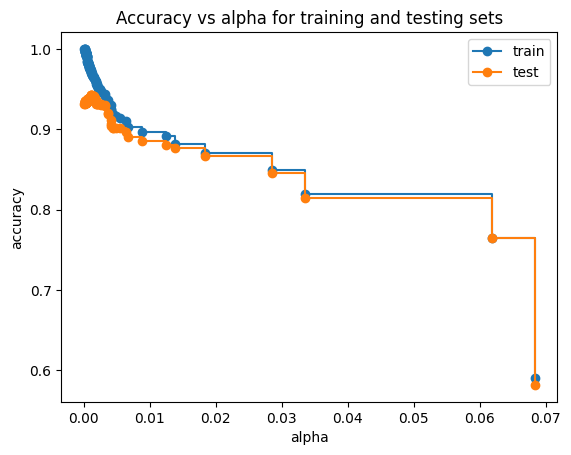

In [ ]:
train_scores = [clf.score(X_train, y_train) for clf in clfs]
test_scores = [clf.score(X_test, y_test) for clf in clfs]
fig, ax = plt.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for training and testing sets")
ax.plot(ccp_alphas, train_scores, marker='o', label="train",drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o', label="test",drawstyle="steps-post")
ax.legend()
plt.show()

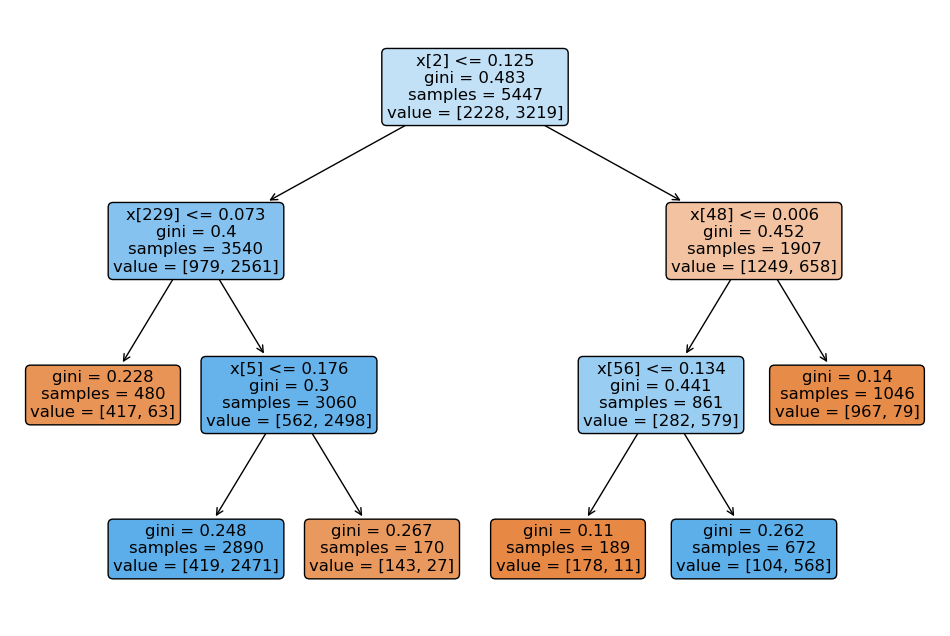

In [ ]:
clf=DecisionTreeClassifier(random_state=0,ccp_alpha=0.02)
clf.fit(X_train,y_train)
plt.figure(figsize=(12,8))
tree.plot_tree(clf,rounded=True,filled=True)
plt.show()

In [ ]:
print(accuracy_score(y_test,clf.predict(X_test)))
print(classification_report(y_test,y_test_predicted))
confusion_matrix(y_test,y_test_predicted)

0.8667400881057269
              precision    recall  f1-score   support

           0       0.94      0.90      0.92       759
           1       0.93      0.96      0.94      1057

    accuracy                           0.93      1816
   macro avg       0.93      0.93      0.93      1816
weighted avg       0.93      0.93      0.93      1816



array([[ 682,   77],
       [  44, 1013]])

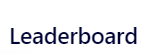

Printed


In [ ]:
from google.colab.patches import cv2_imshow


image1 = cv2.imread("/content/Screenshot 2024-07-12 044857.png")
# Predict using the trained classifier
cv2_imshow(image1)
feature1 = load_extract_feature("/content/Screenshot 2024-07-12 044857.png")
feature2 = feature1.reshape(1,324)
prediction = clf.predict(feature2)


# Draw bounding box and label on the image
label = "Handwritten" if prediction == 0 else "Printed"
color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
print(label)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
clf_2 = RandomForestClassifier(max_depth=8, random_state=0)
clf_2.fit(X_train, y_train)

RandomForestClassifier(max_depth=8, random_state=0)

In [ ]:
y_predicted=clf_2.predict(X_test)
print(accuracy_score(y_test,y_predicted))
print(classification_report(y_test,y_predicted))
confusion_matrix(y_test,y_predicted)

0.9741189427312775
              precision    recall  f1-score   support

           0       0.99      0.95      0.97       759
           1       0.97      0.99      0.98      1057

    accuracy                           0.97      1816
   macro avg       0.98      0.97      0.97      1816
weighted avg       0.97      0.97      0.97      1816



array([[ 723,   36],
       [  11, 1046]])

In [ ]:
# from google.colab.patches import cv2_imshow


# image1 = cv2.imread("/content/Screenshot 2024-07-06 111028.png")
# # Predict using the trained classifier
# cv2_imshow(image1)
# feature1 = load_extract_feature("/content/Screenshot 2024-07-06 111028.png")
# feature2 = feature1.reshape(1,324)
# prediction = clf.predict(feature2)


# # Draw bounding box and label on the image
# label = "Handwritten" if prediction == 0 else "Printed"
# color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
# print(label)
# # cv2.rectangle(feature1, (x, y), (x+w, y+h), color, 2)
# # cv2.putText(word_img, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

AttributeError: 'NoneType' object has no attribute 'clip'

In [ ]:
from sklearn.model_selection import cross_val_score

model = RandomForestClassifier()
scores = cross_val_score(model, A,B, cv=5)

print("Cross-validation scores:", scores)
print("Mean accuracy:", scores.mean())

Cross-validation scores: [0.74522901 0.74332061 0.77363897 0.7574021  0.75167144]
Mean accuracy: 0.7542524260518967


DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=209652396)


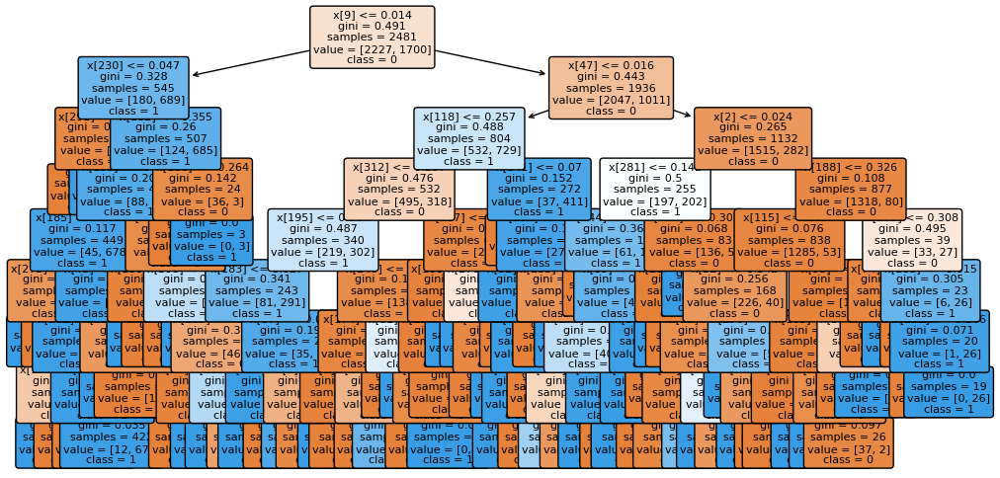

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=398764591)


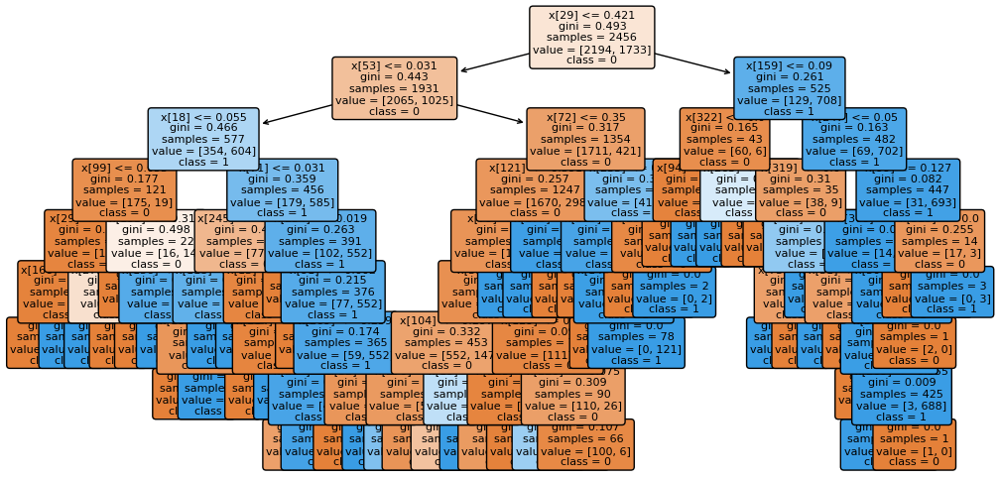

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=924231285)


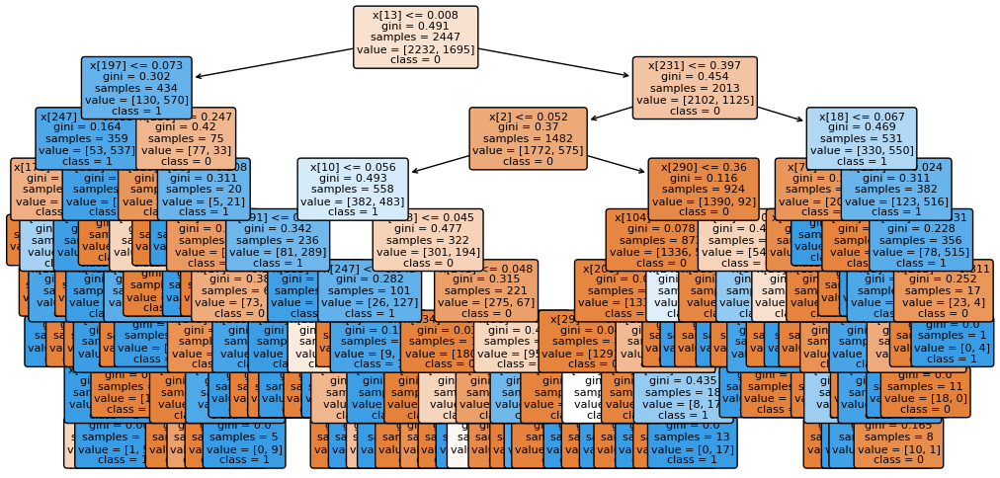

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1478610112)


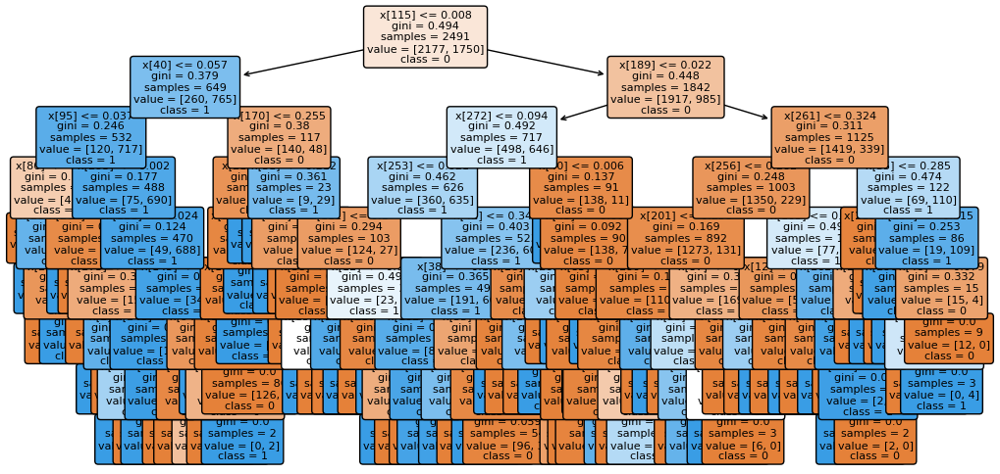

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=441365315)


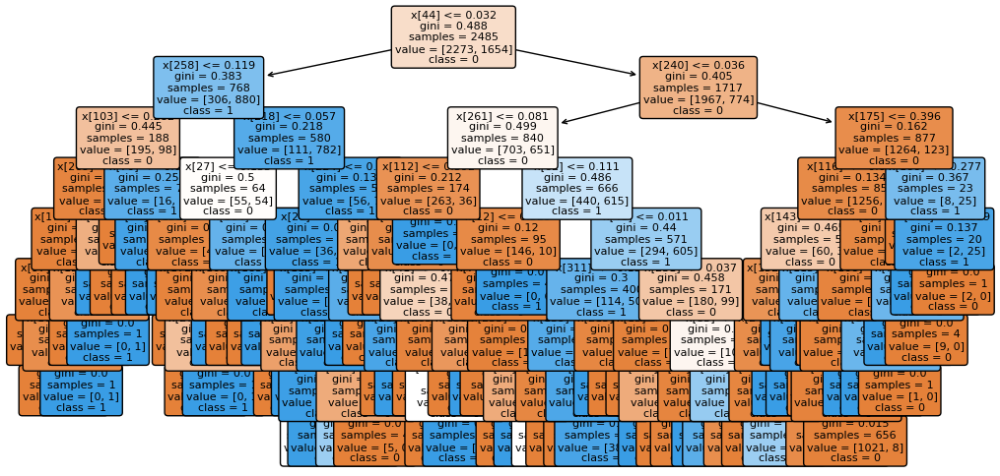

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1537364731)


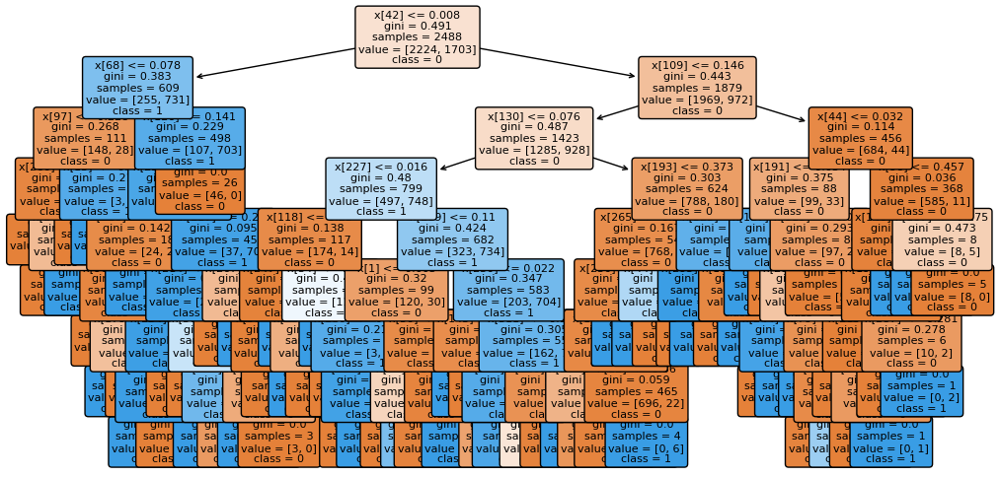

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=192771779)


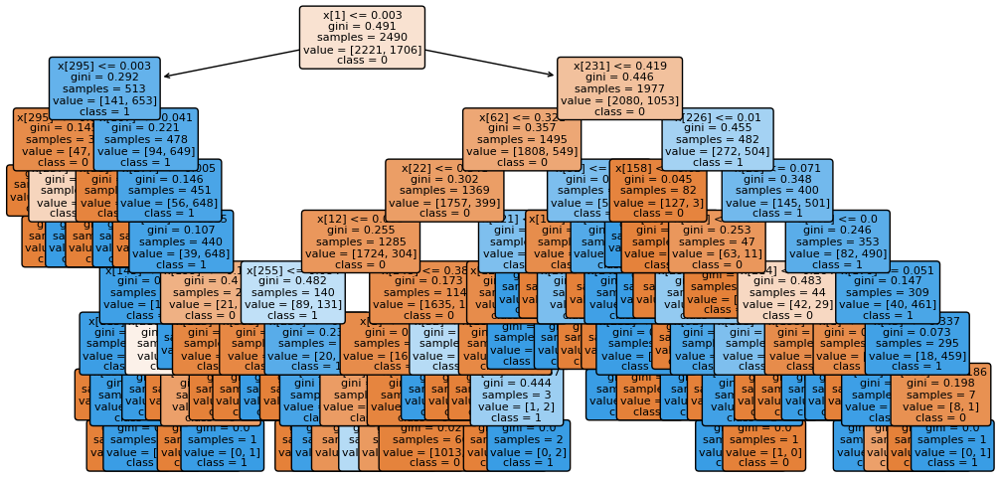

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1491434855)


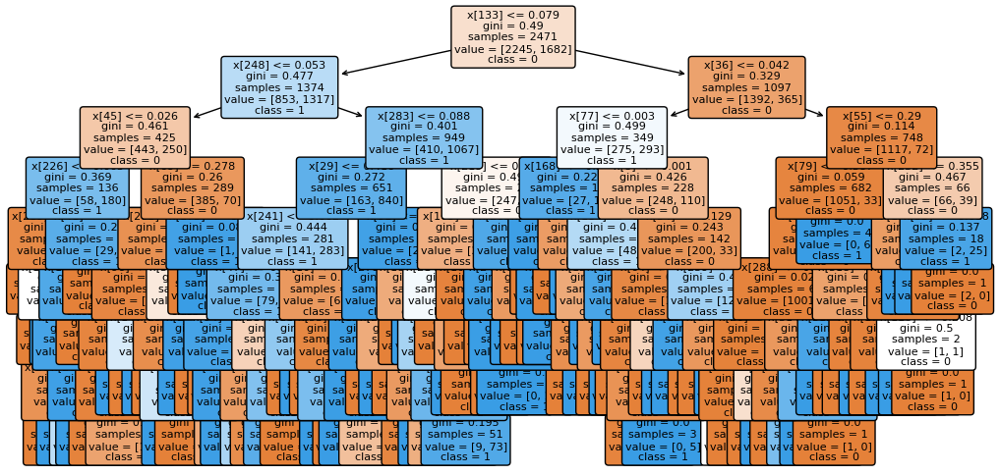

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1819583497)


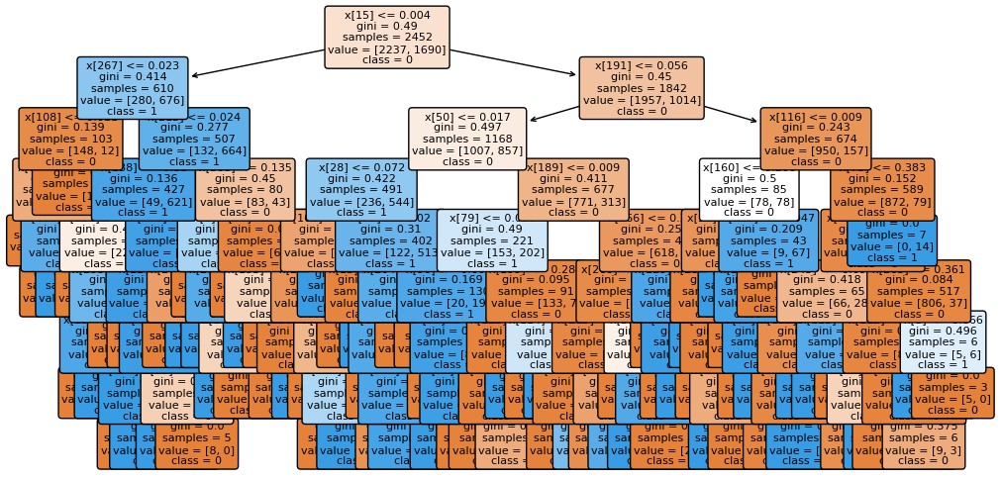

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=530702035)


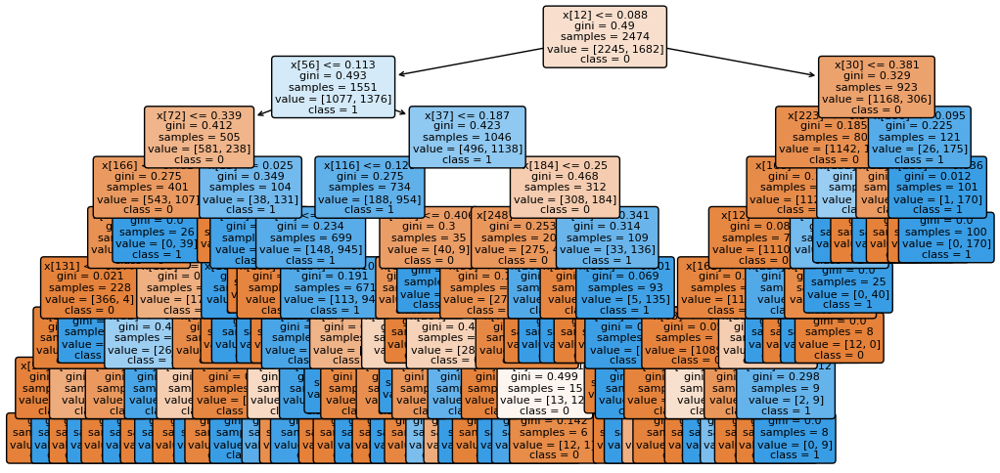

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=626610453)


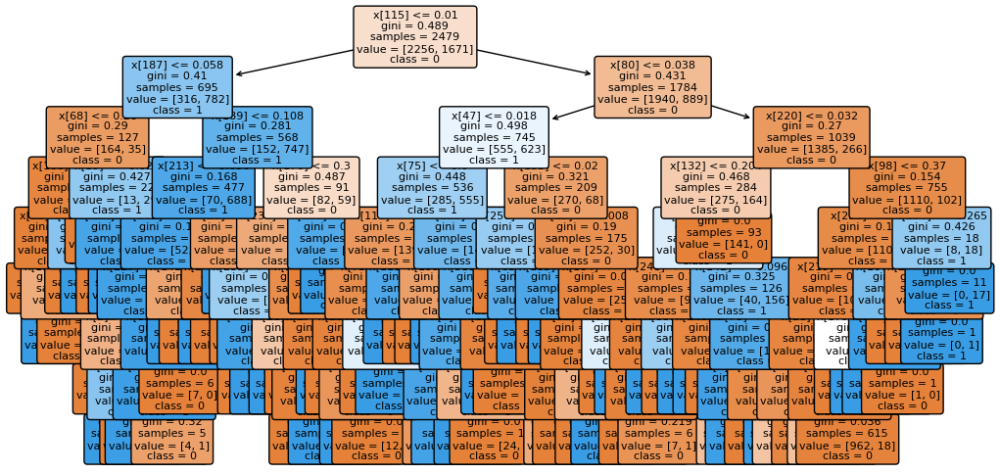

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1650906866)


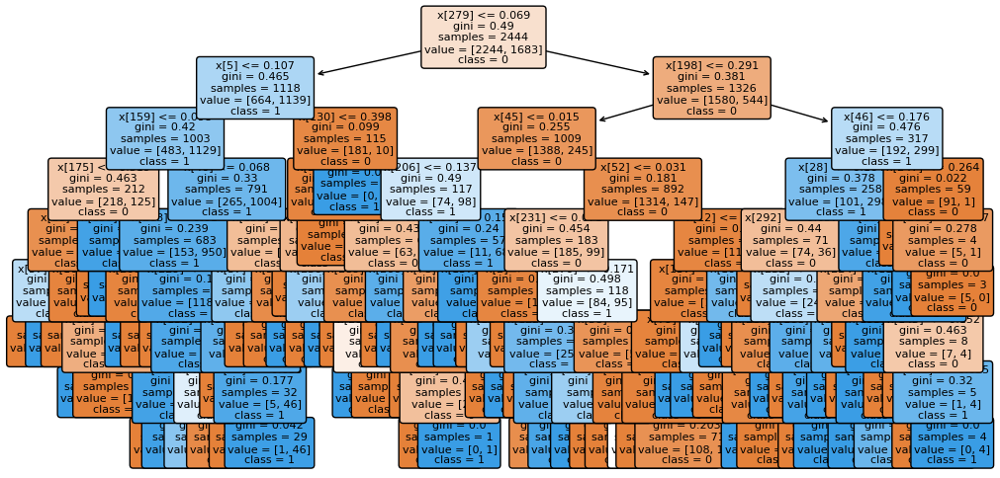

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1879422756)


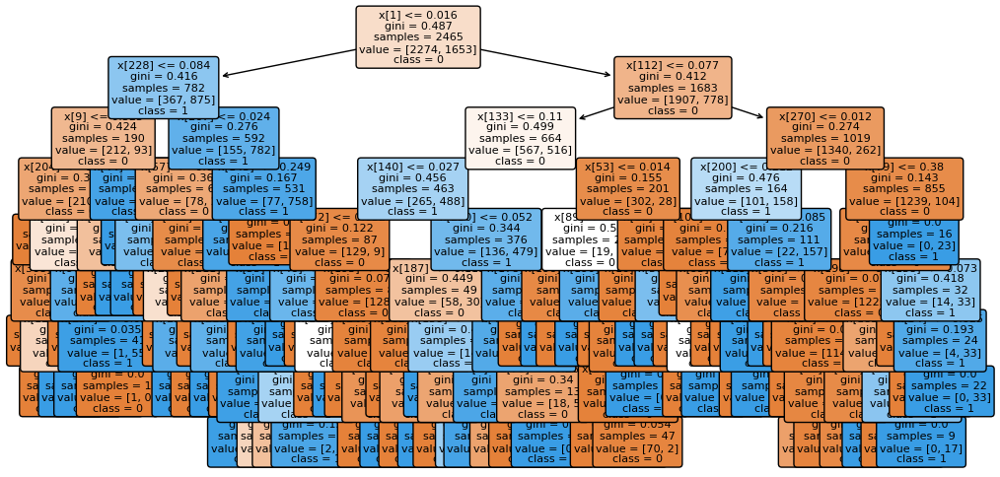

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1277901399)


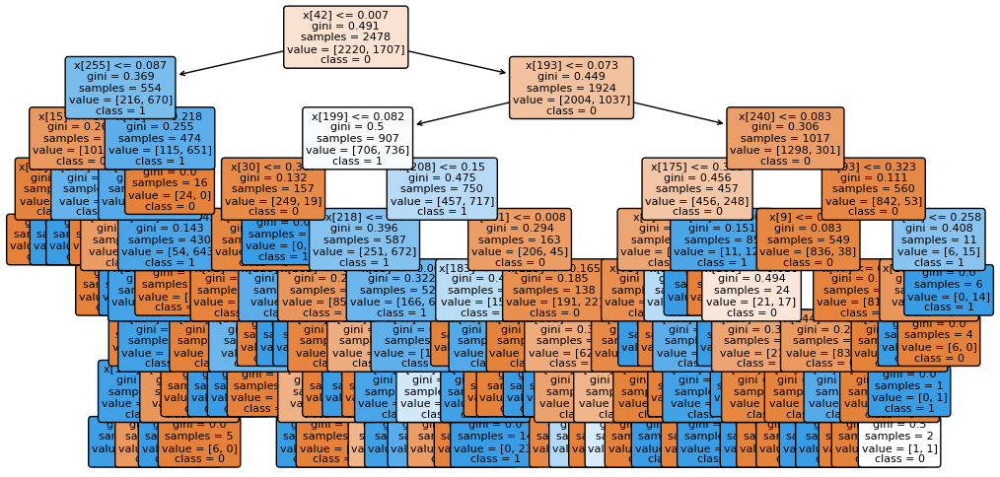

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1682652230)


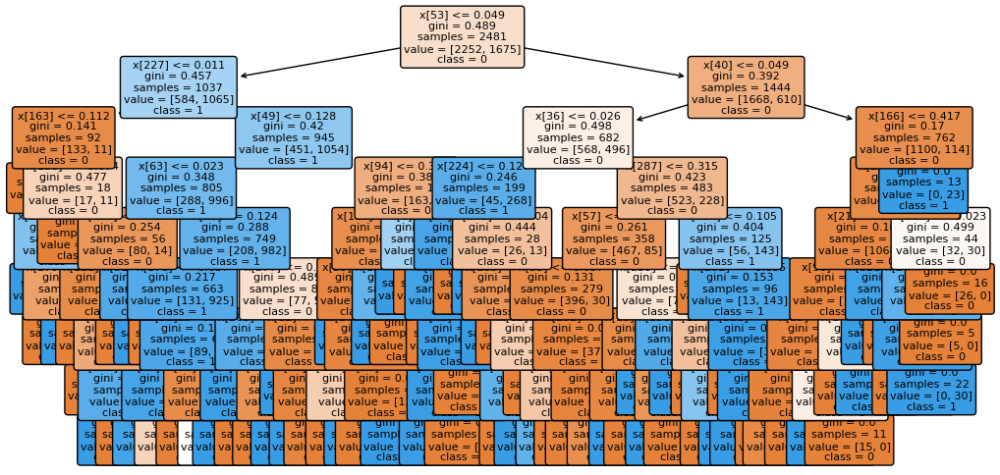

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=243580376)


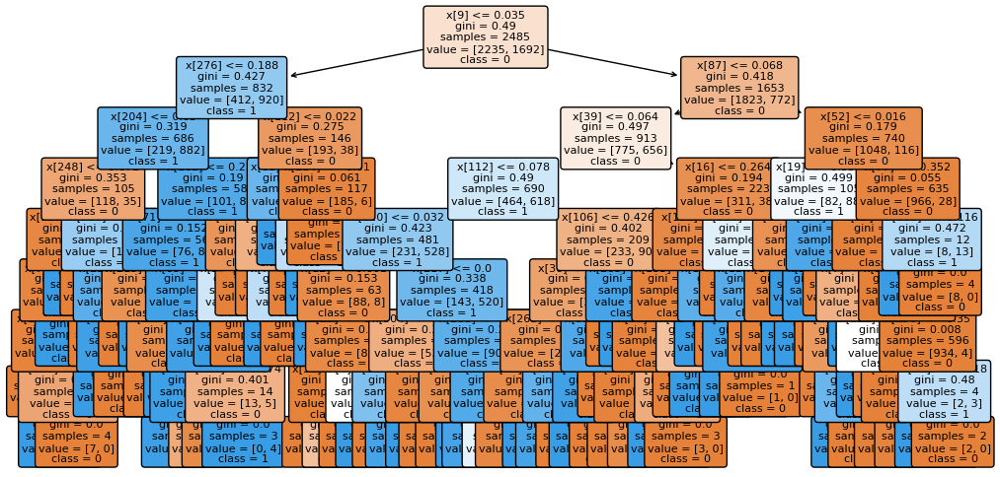

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1991416408)


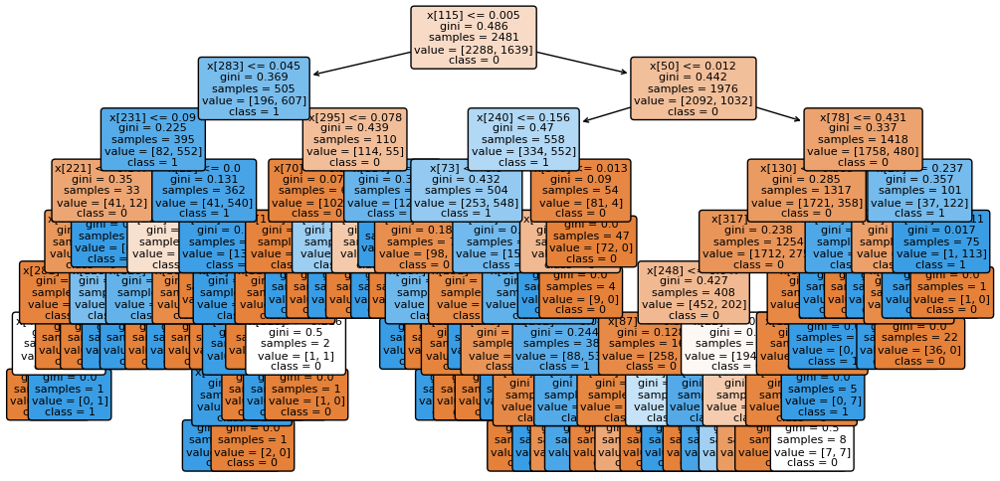

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1171049868)


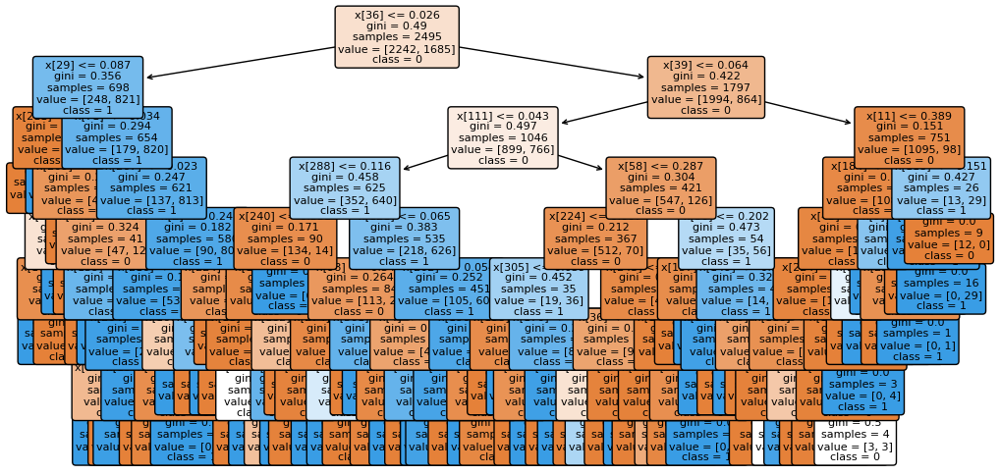

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1646868794)


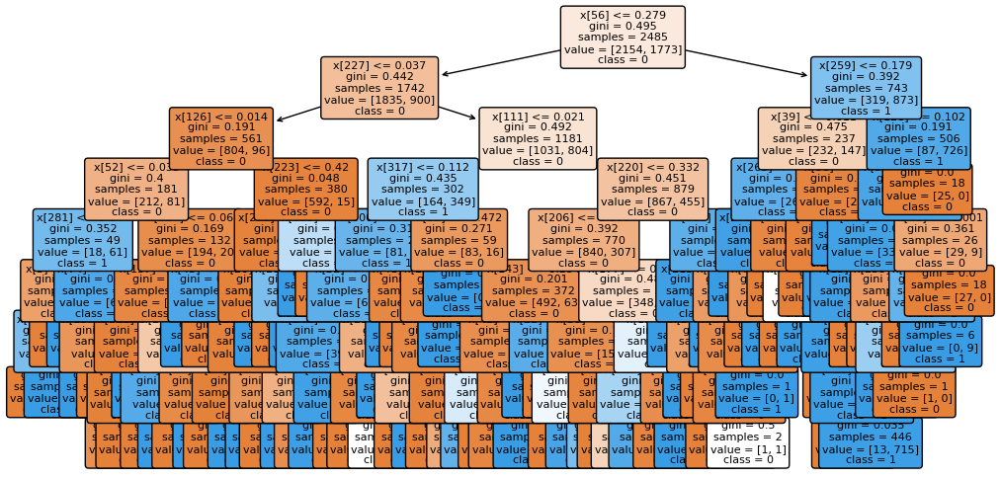

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=2051556033)


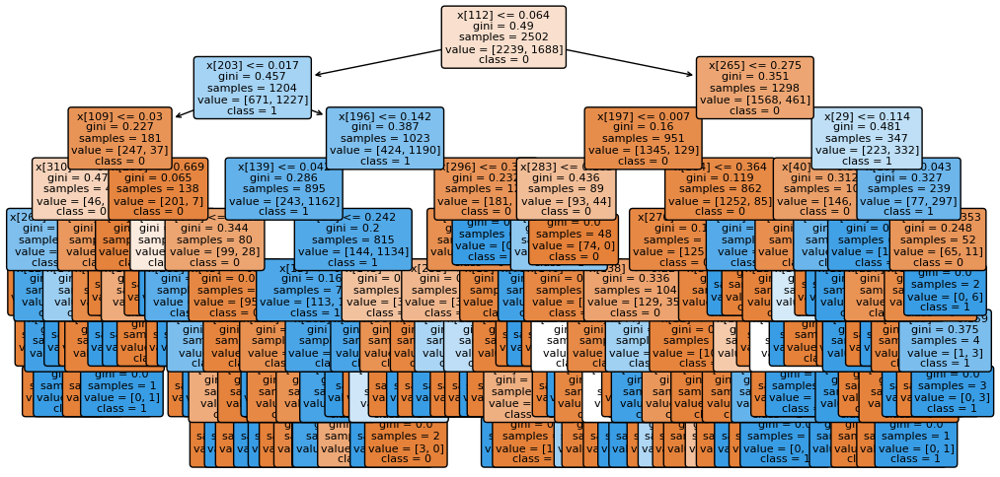

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1252949478)


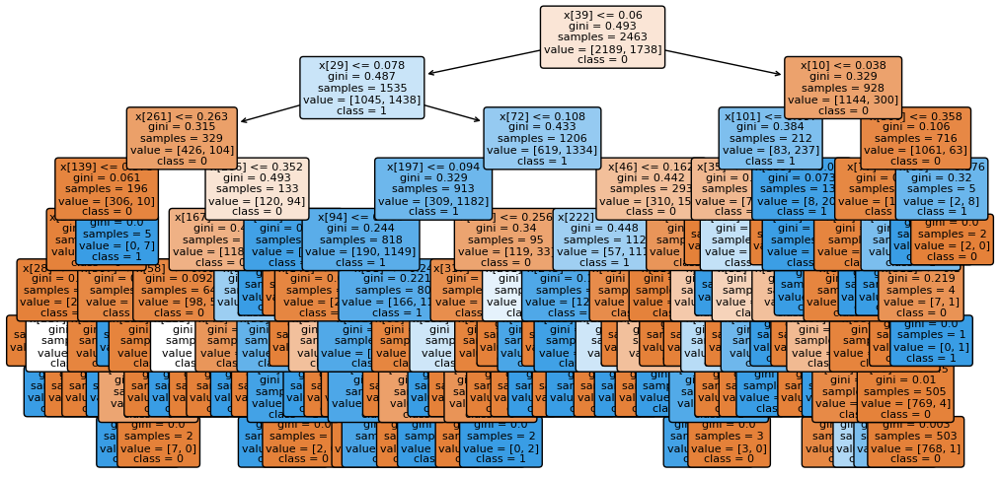

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1340754471)


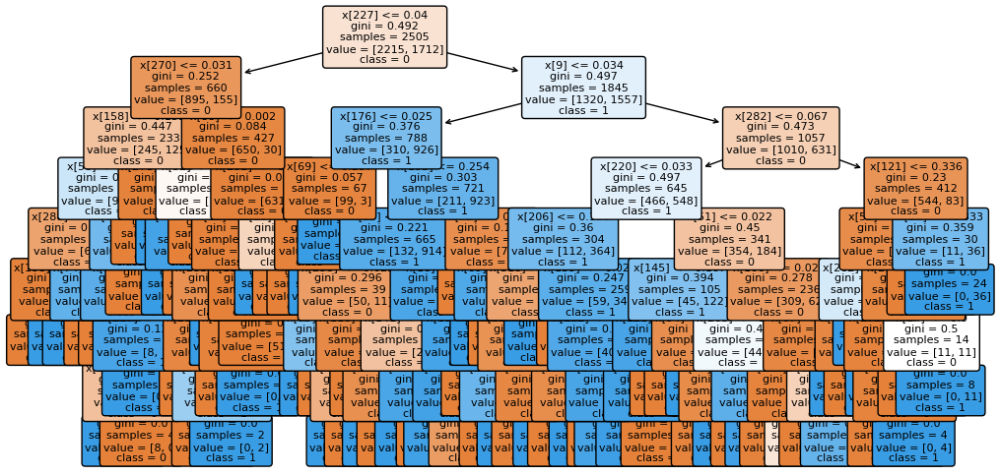

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=124102743)


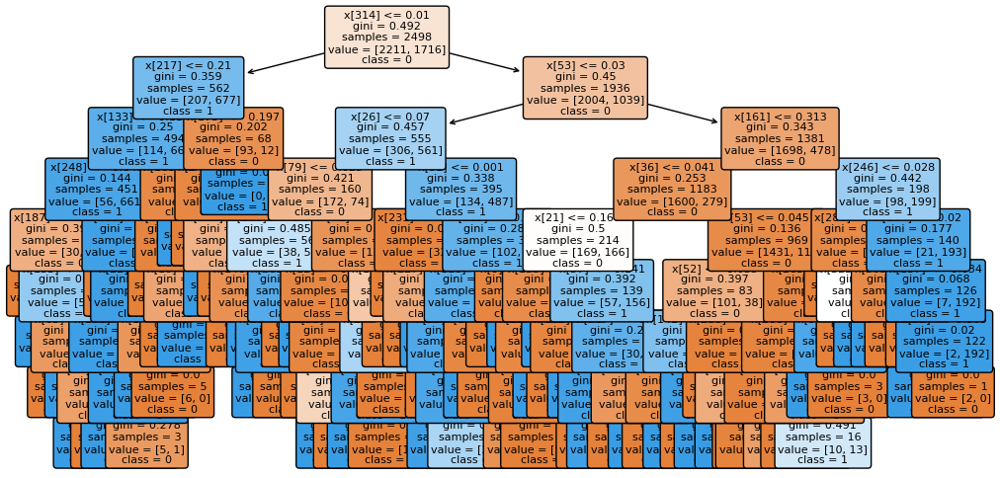

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=2061486254)


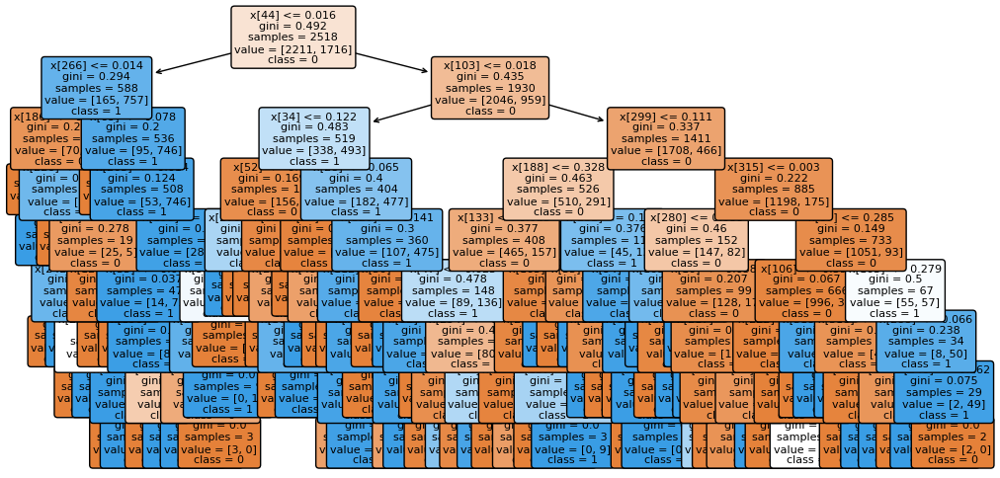

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=292249176)


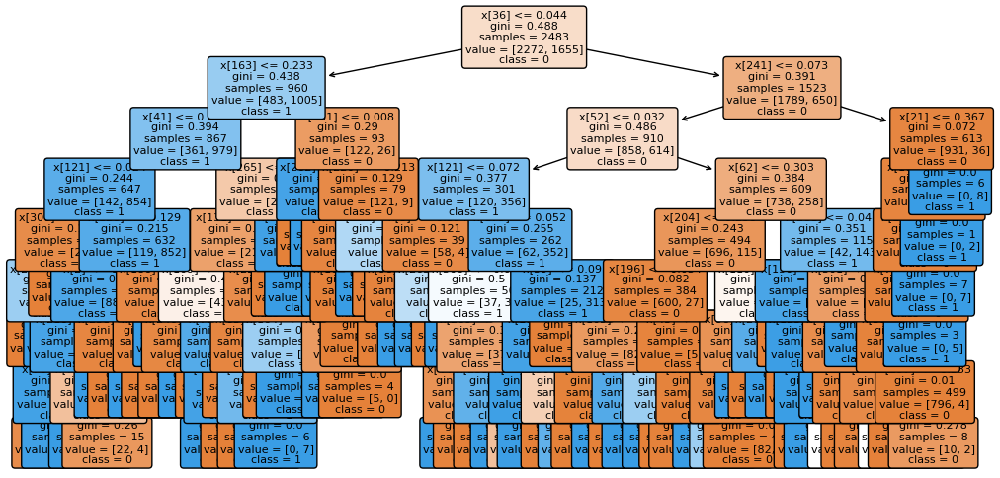

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1686997841)


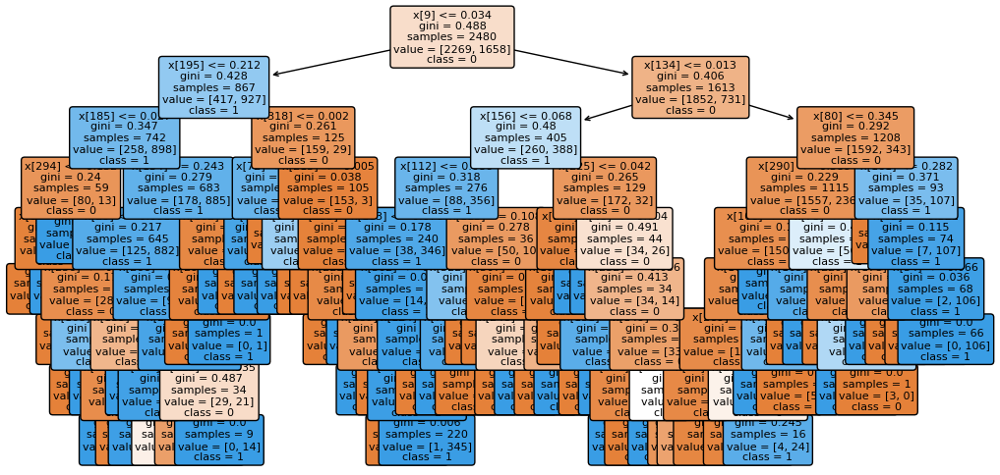

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1827923621)


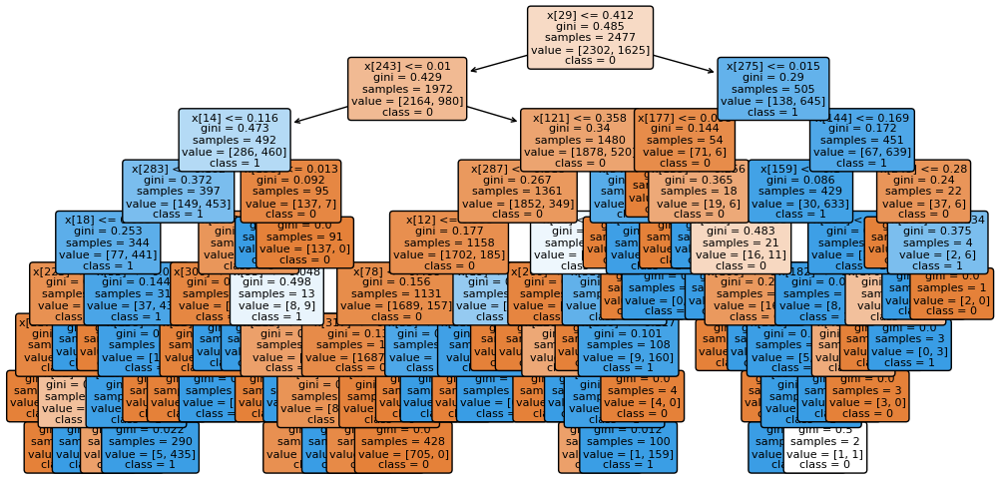

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1443447321)


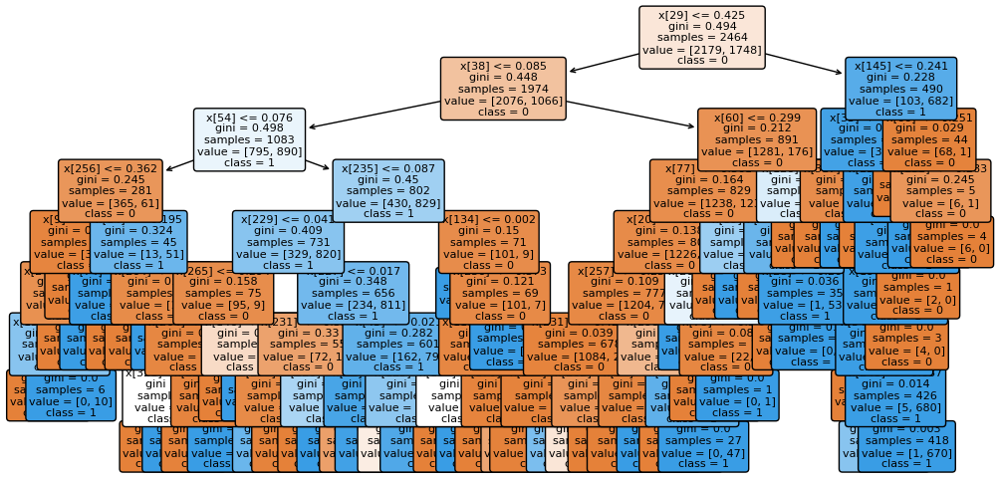

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=305097549)


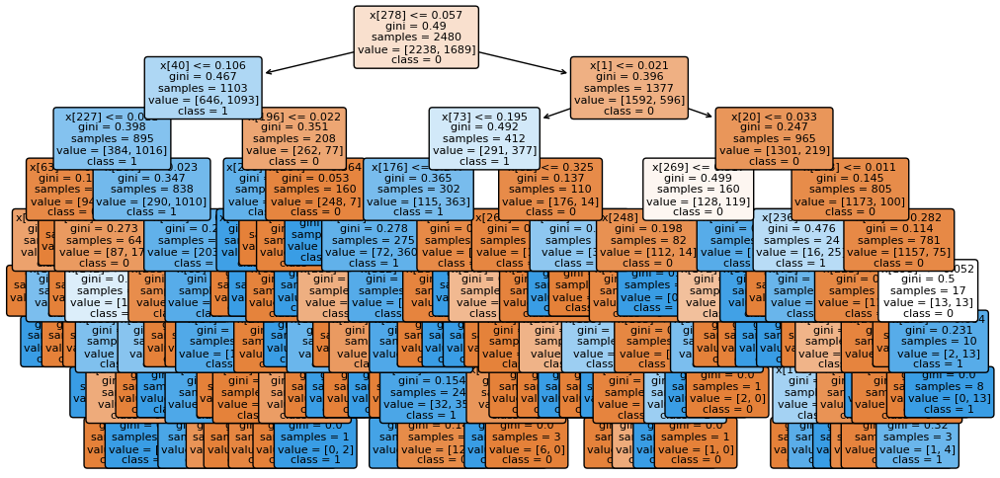

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1449105480)


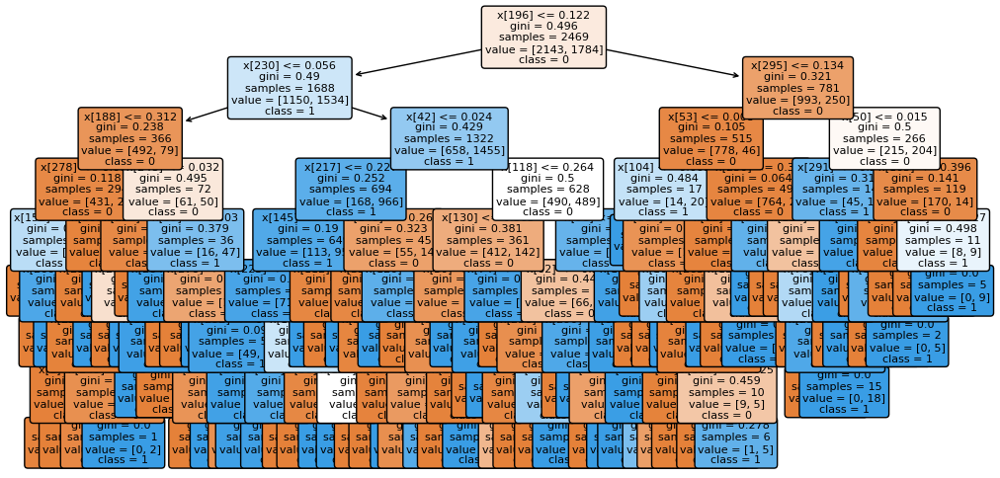

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=374217481)


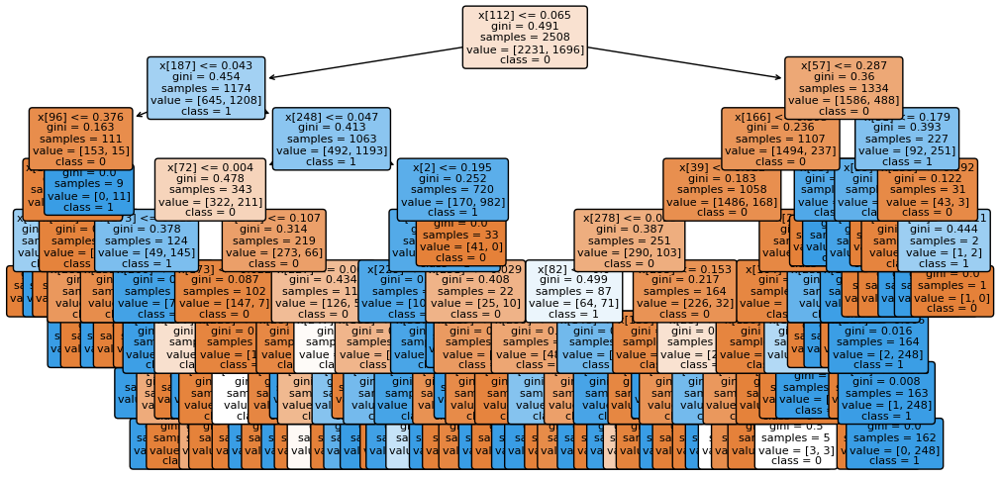

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=636393364)


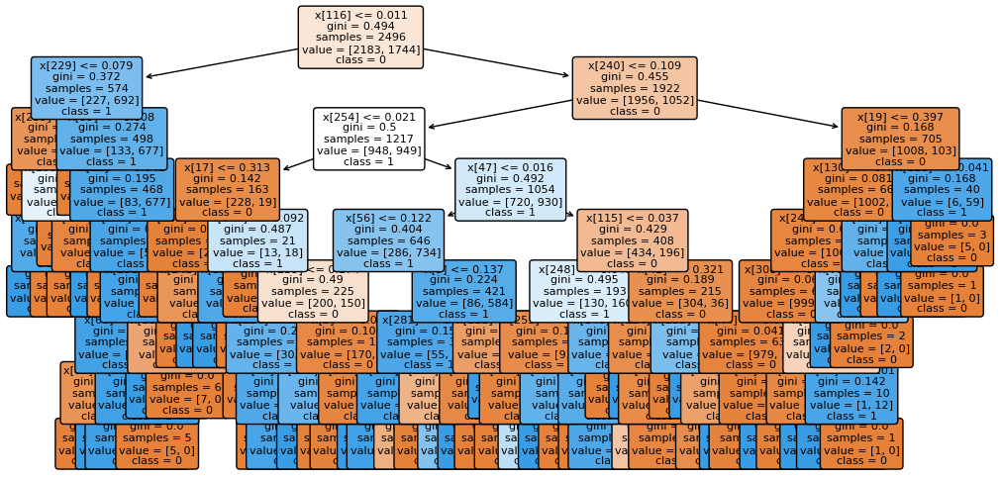

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=86837363)


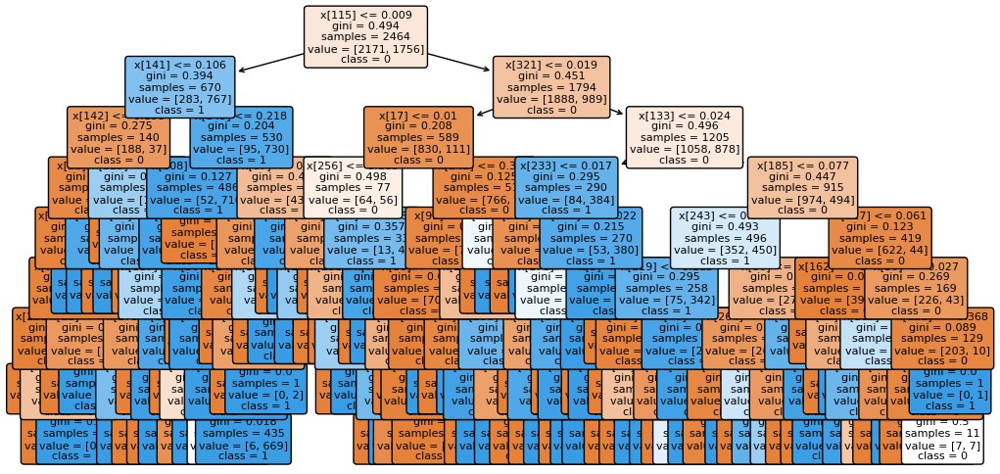

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1581585360)


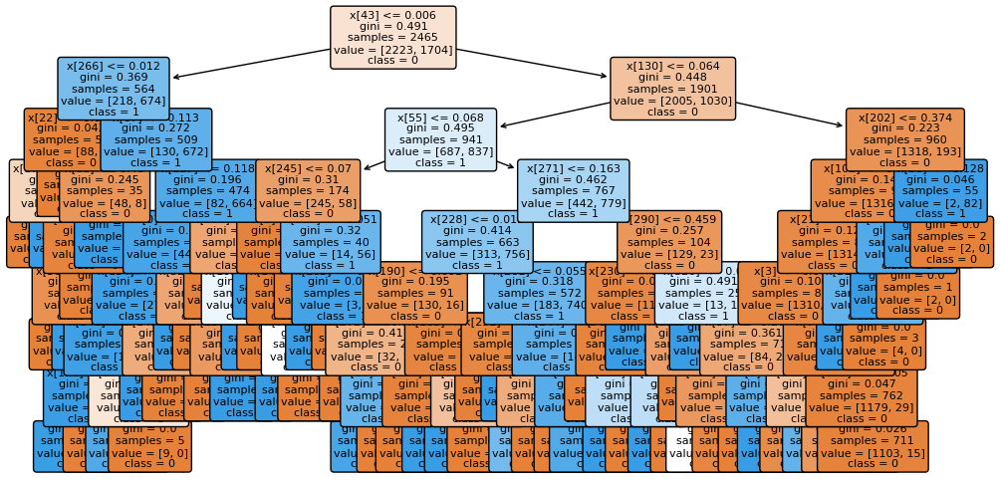

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1428591347)


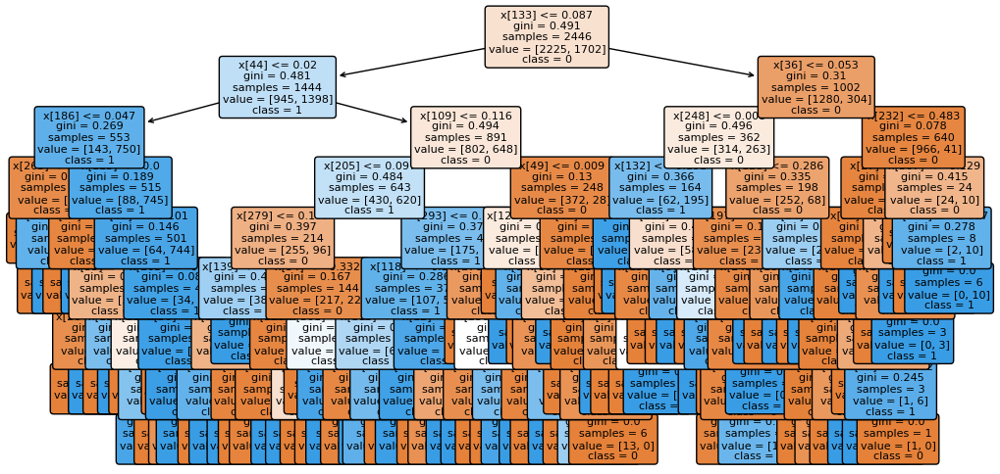

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1963466437)


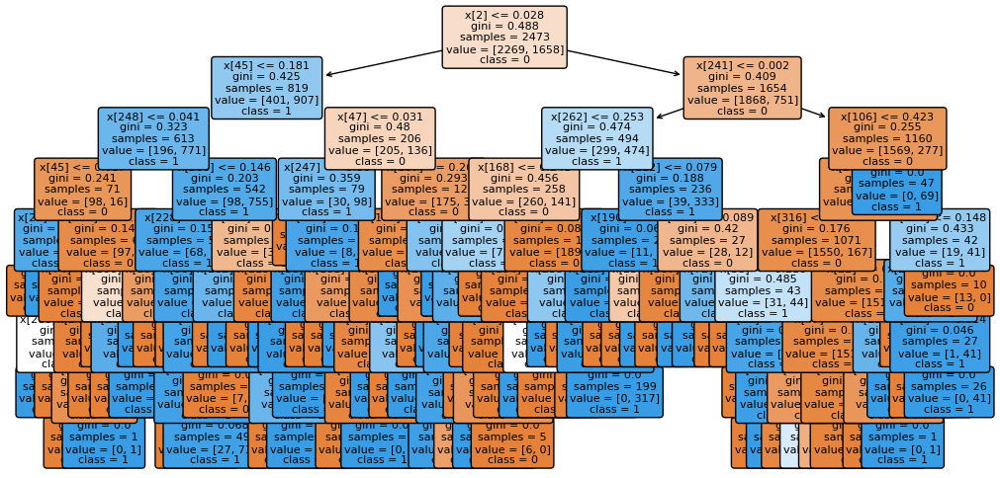

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1194674174)


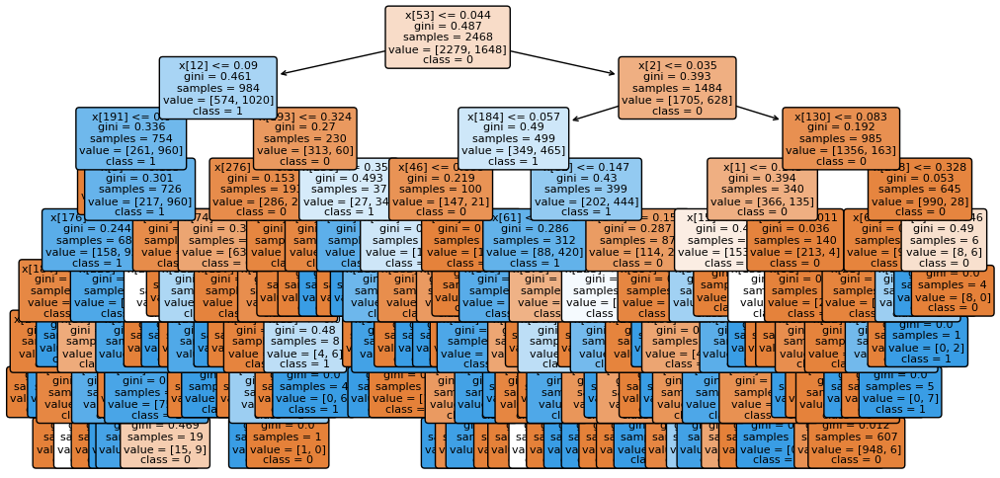

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=602801999)


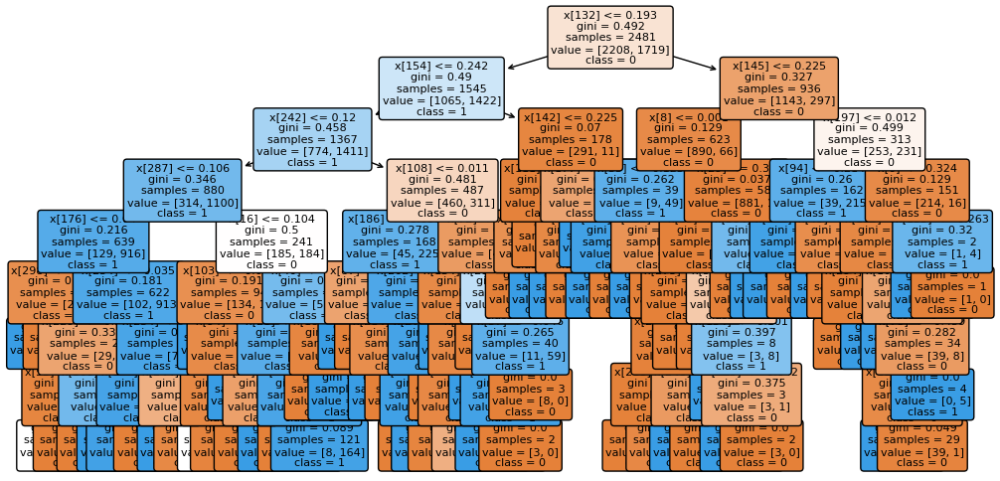

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1589190063)


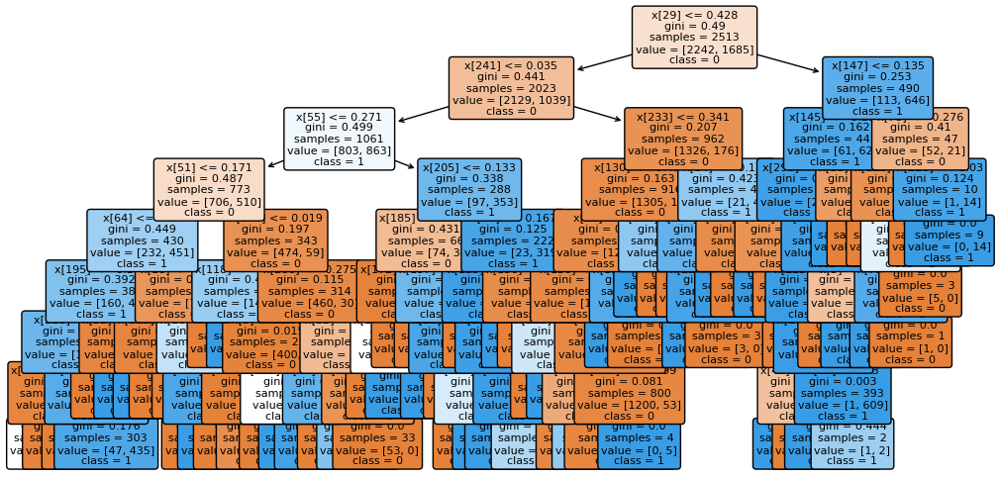

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1589512640)


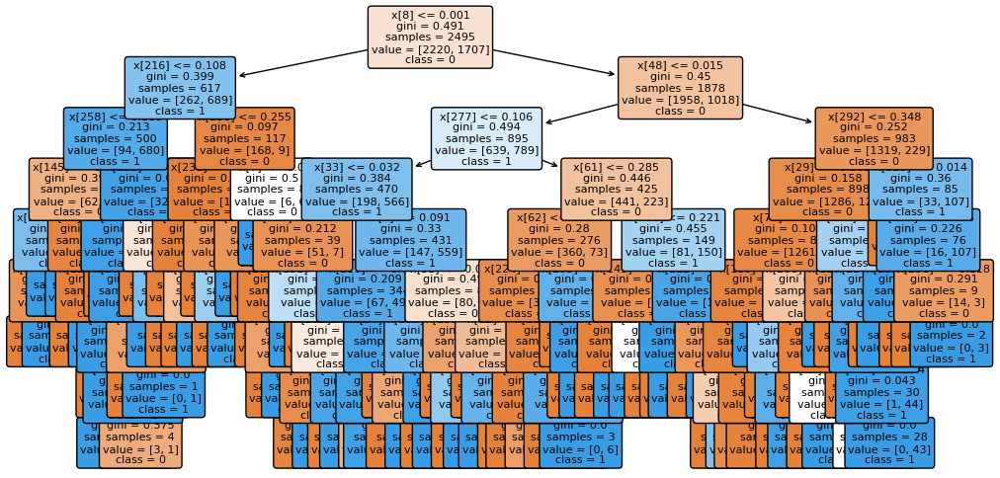

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=2055650130)


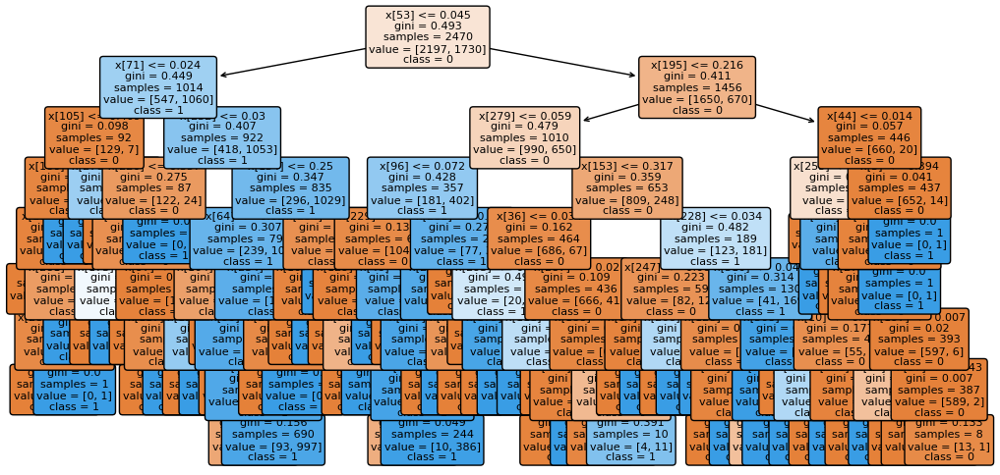

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=2034131043)


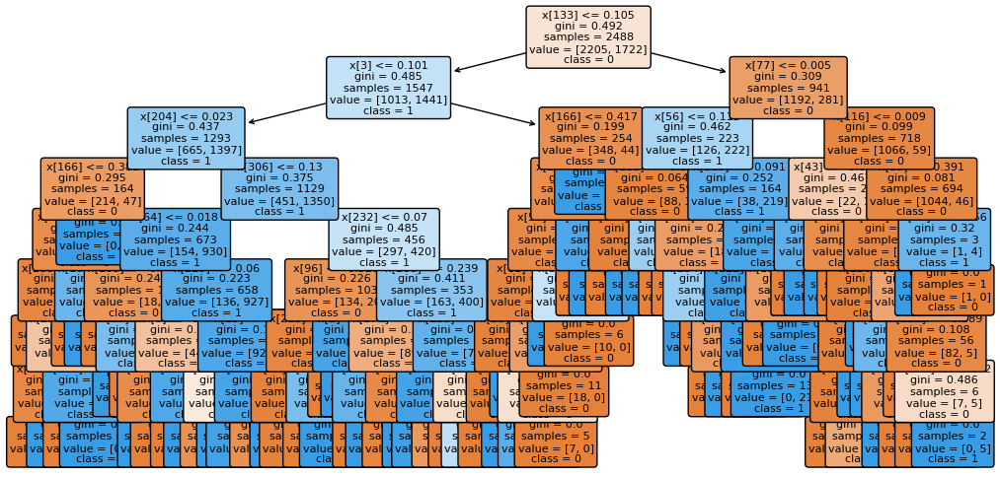

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1284876248)


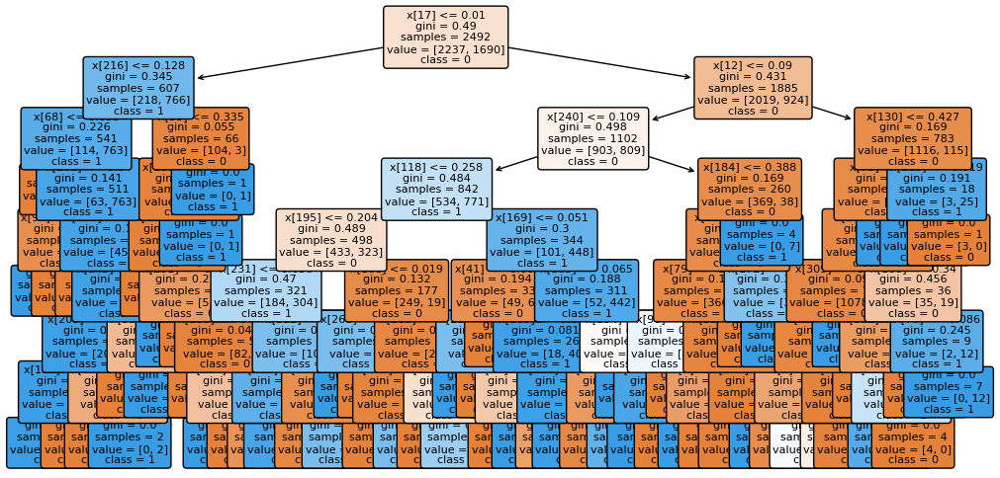

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1292401841)


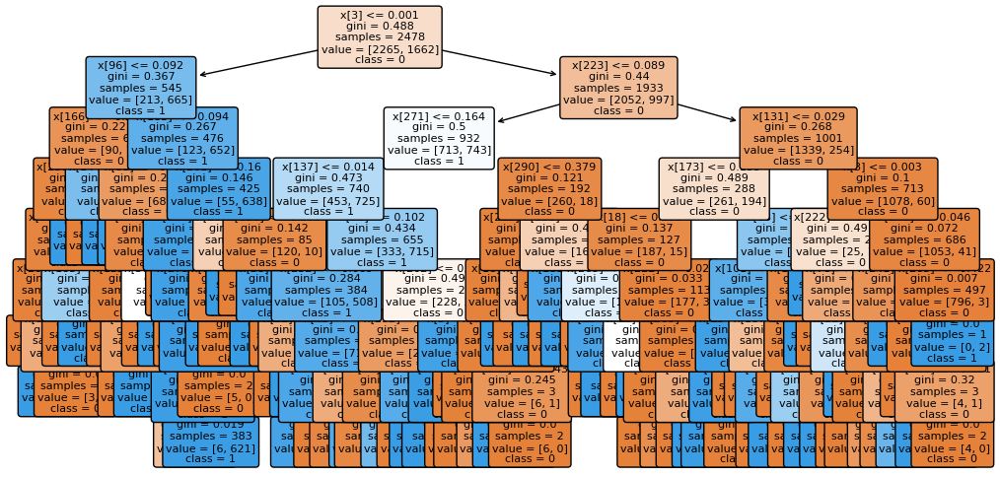

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1982038771)


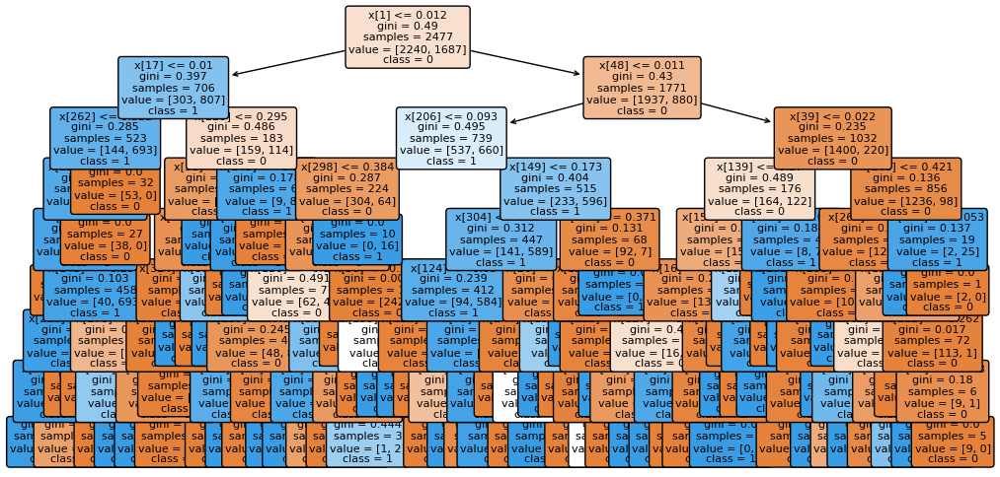

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=87950109)


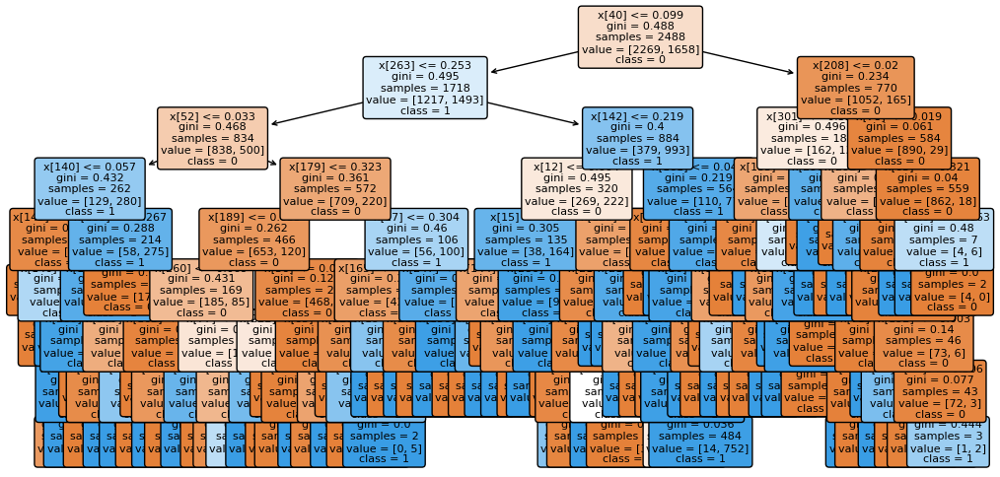

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1204863635)


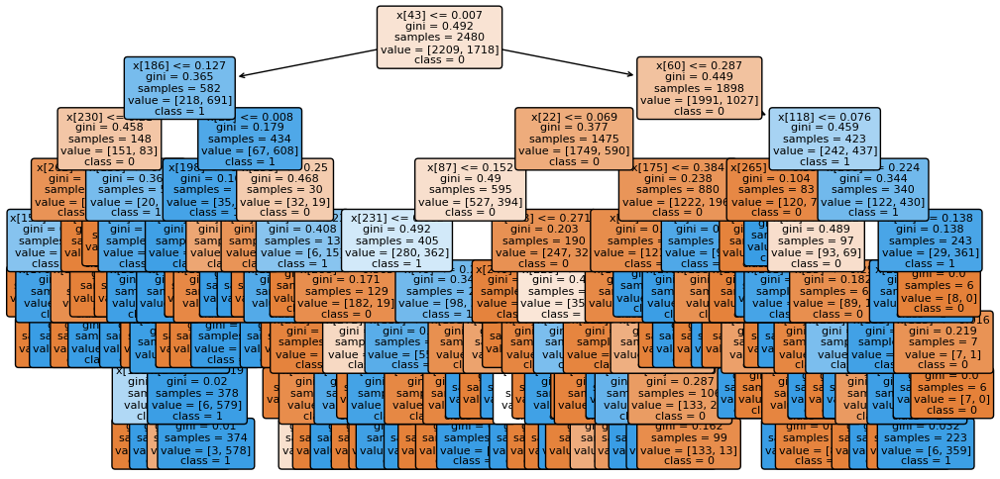

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=768281747)


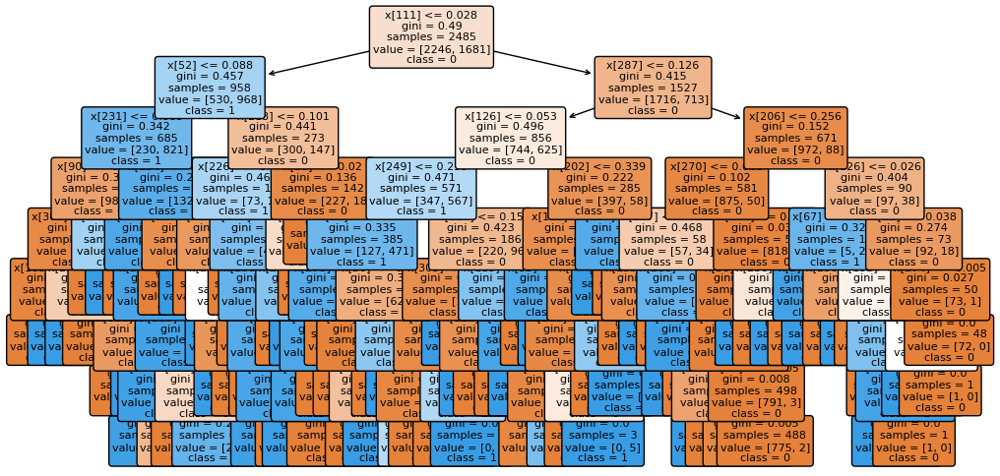

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=507984782)


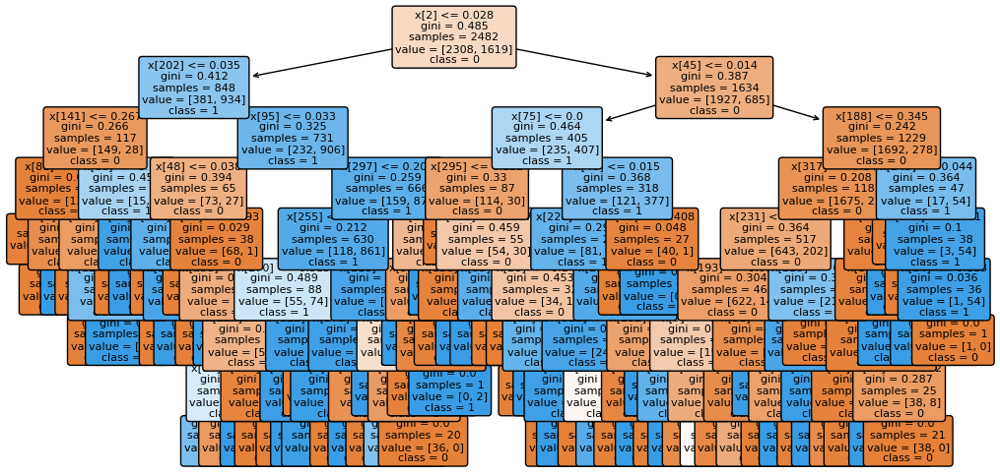

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=947610023)


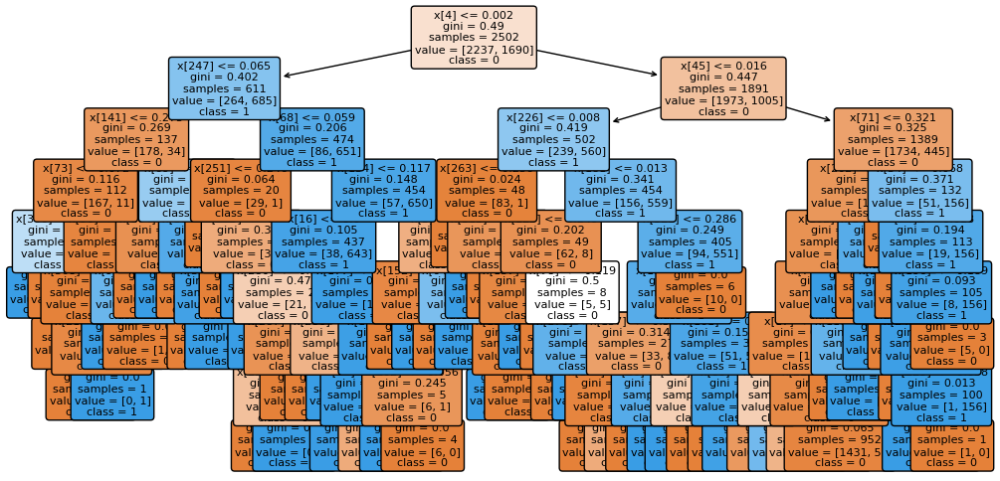

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=600956192)


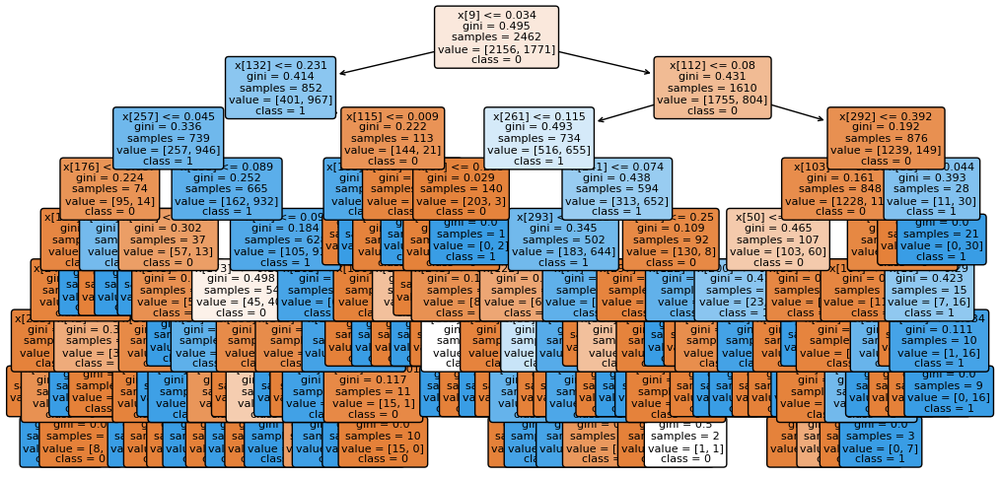

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=352272321)


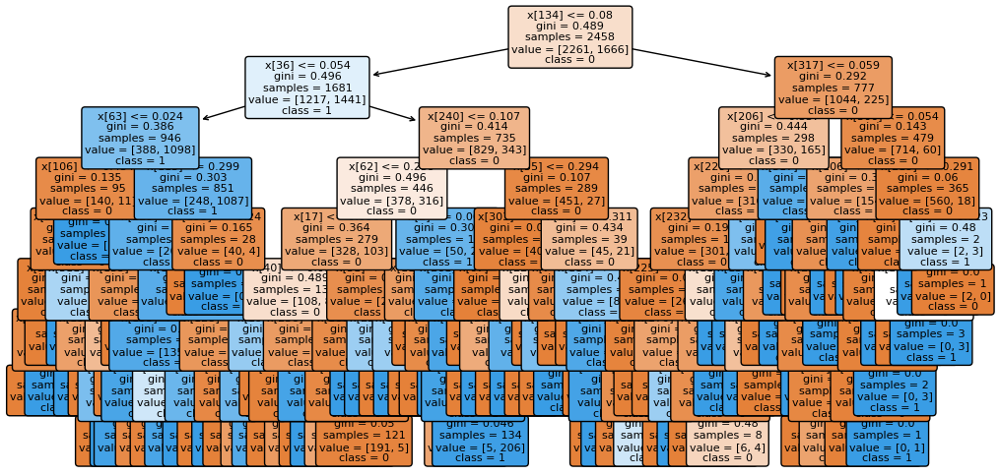

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=615697673)


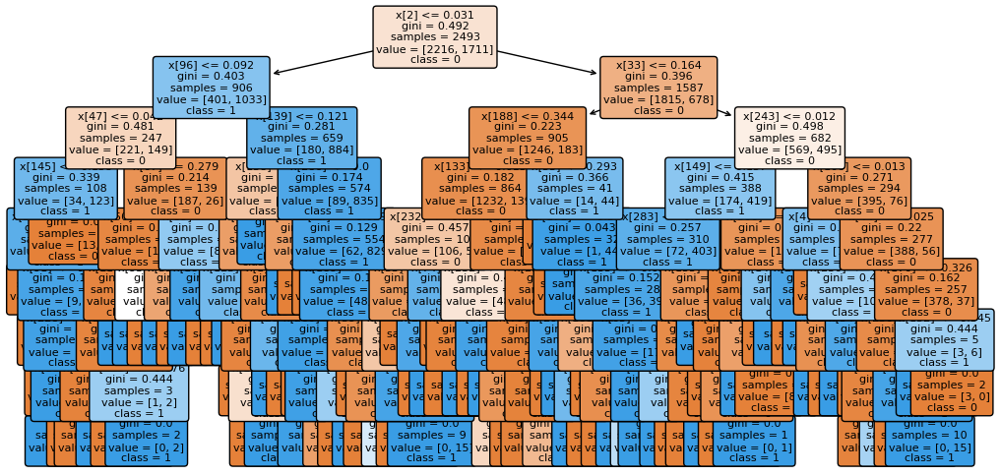

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=160516793)


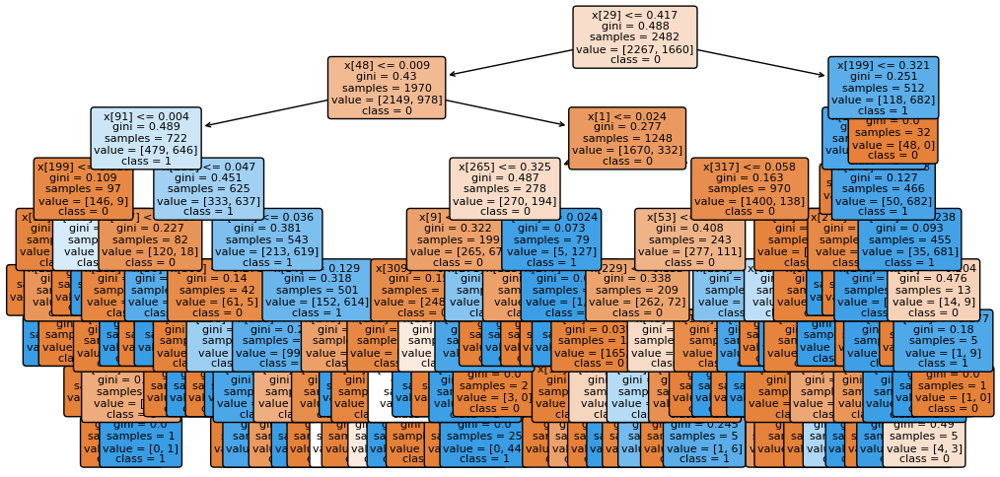

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1909838463)


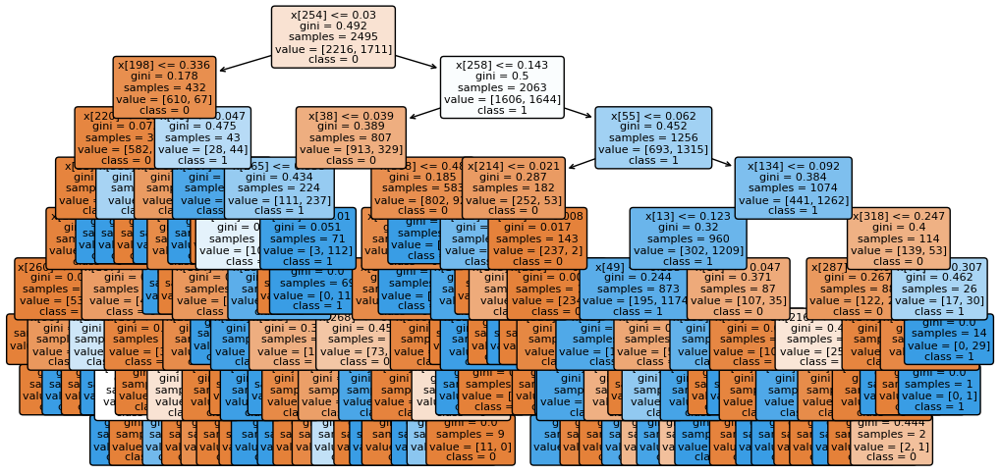

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1110745632)


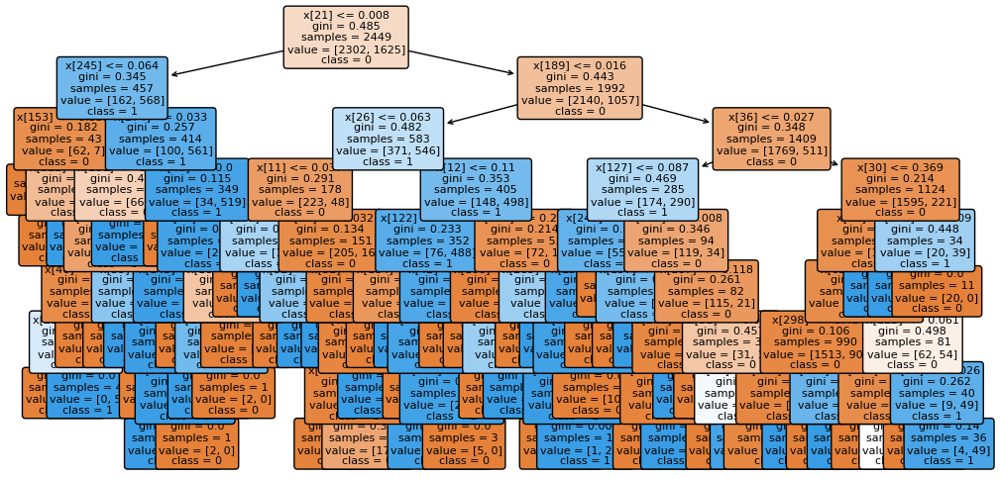

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=93837855)


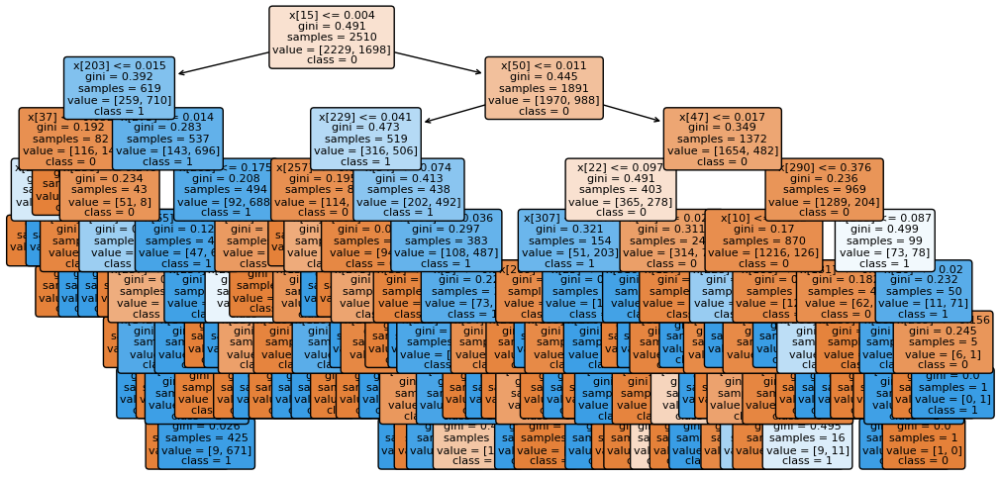

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=454869706)


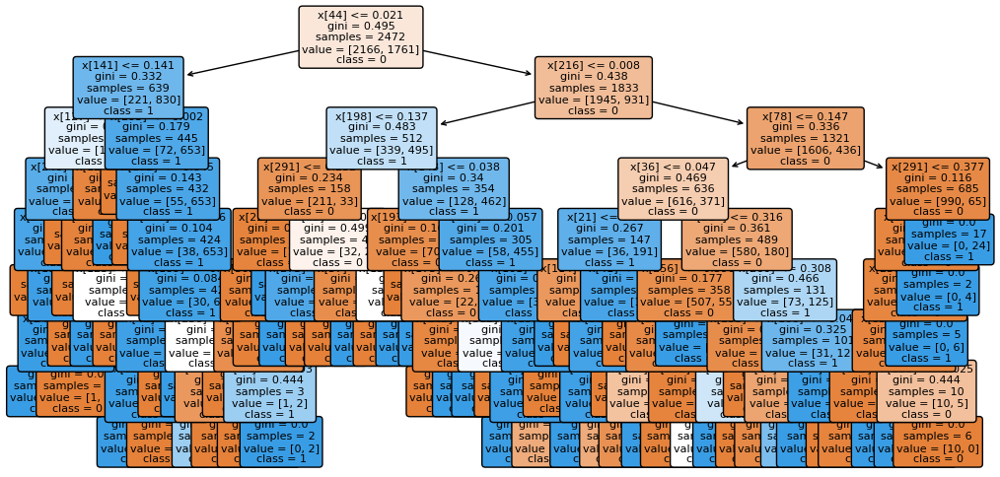

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1780959476)


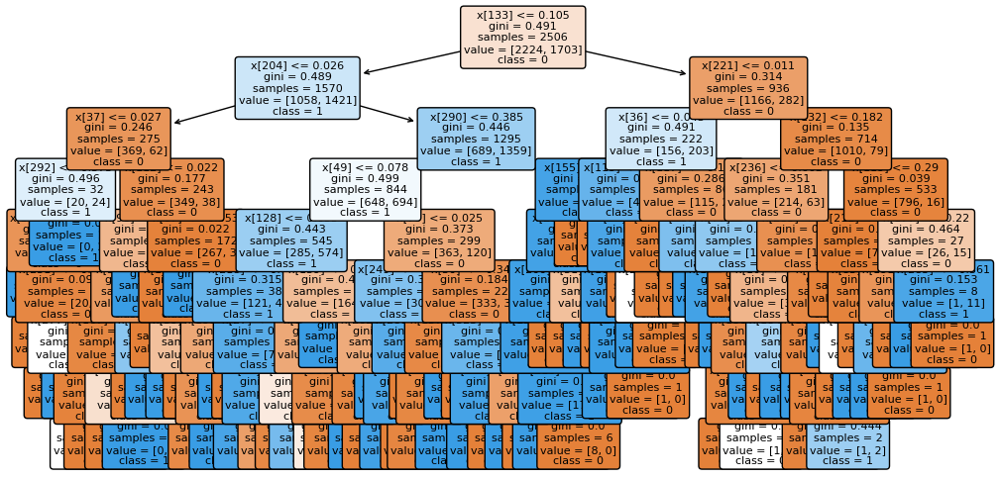

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=2034098327)


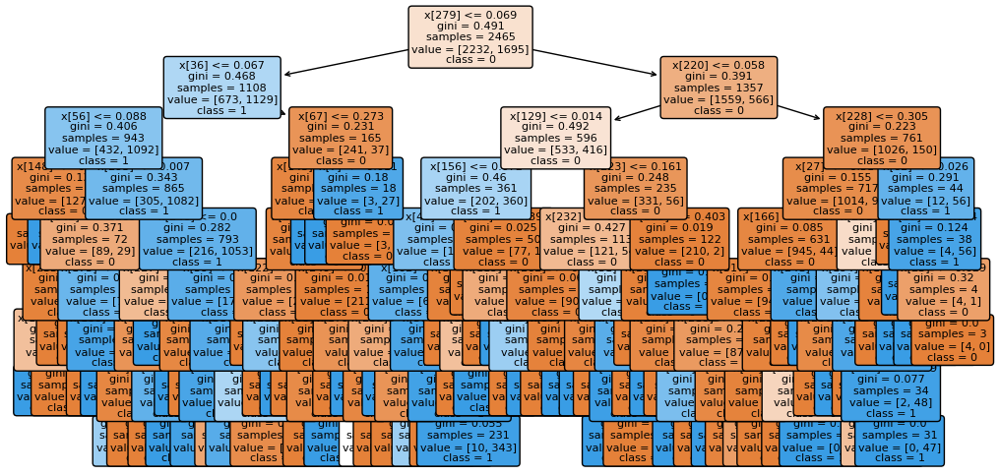

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1136257699)


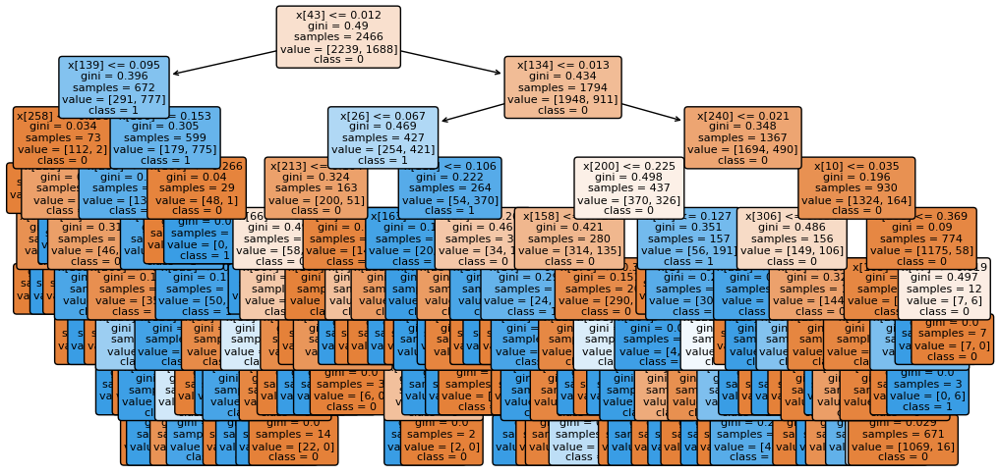

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=800291326)


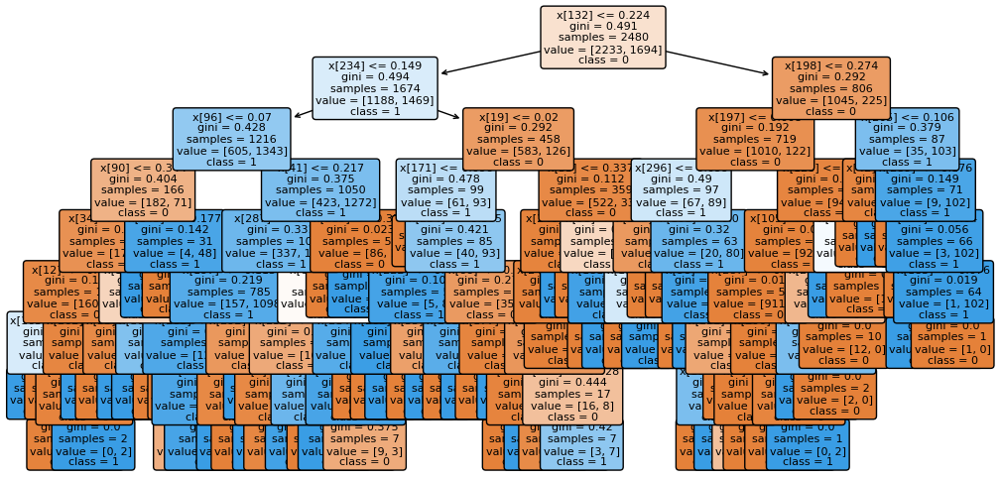

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1177824715)


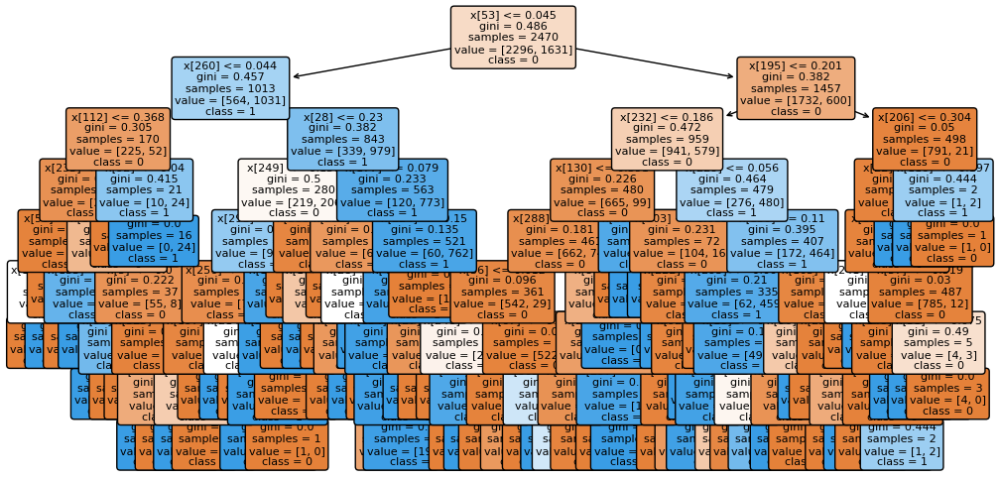

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1017555826)


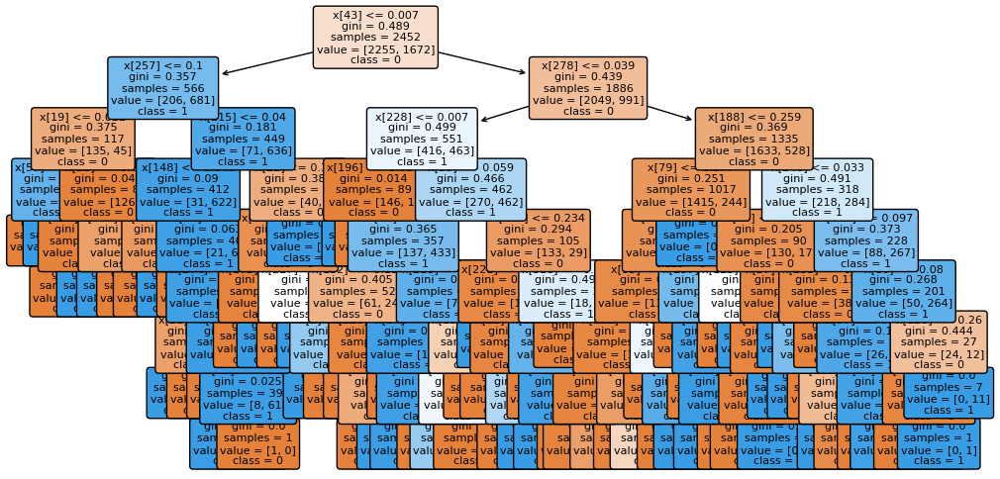

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1959150775)


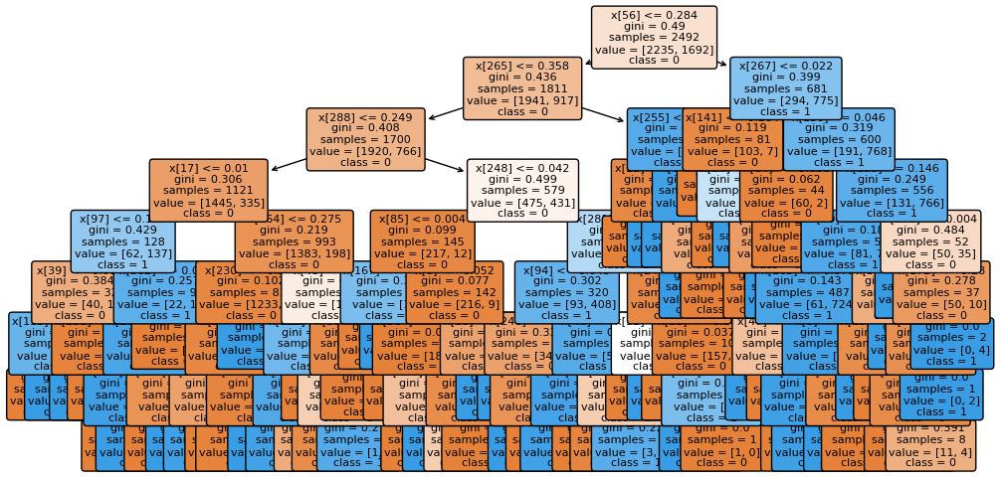

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=930076700)


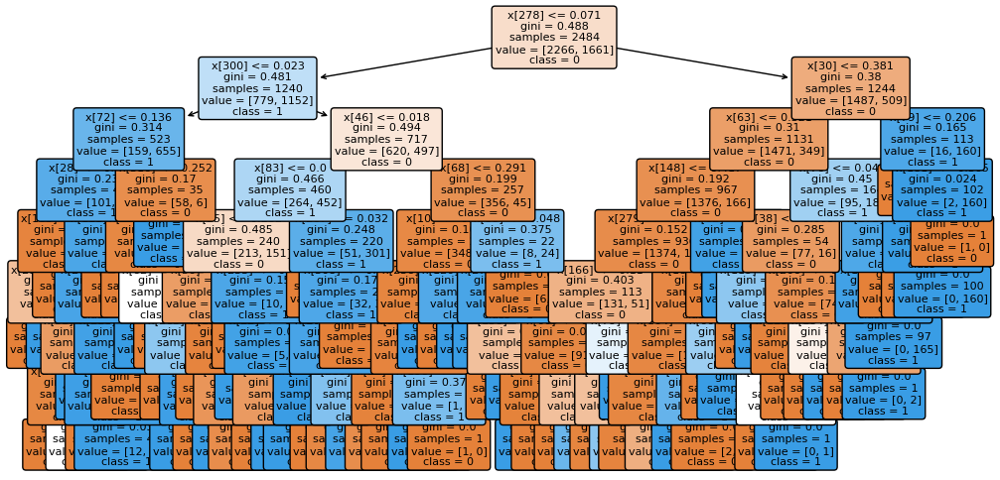

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=293921570)


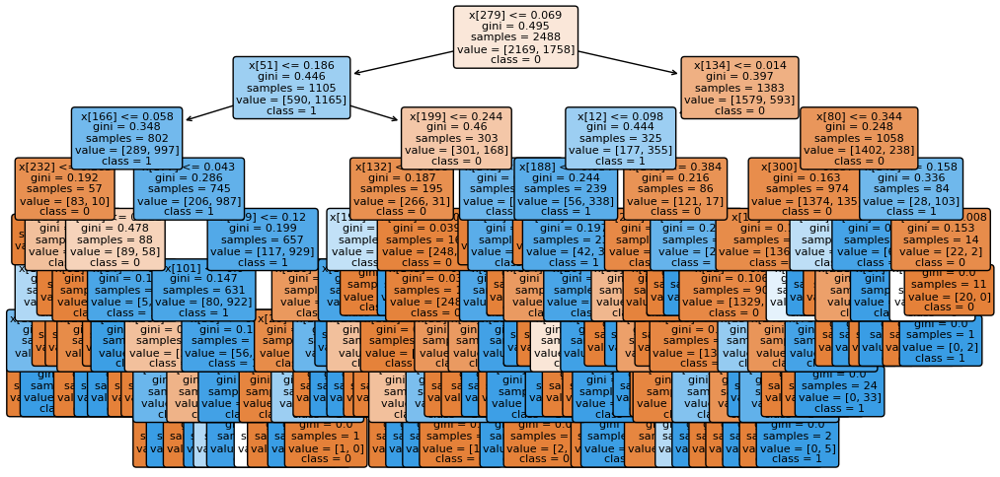

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=580757632)


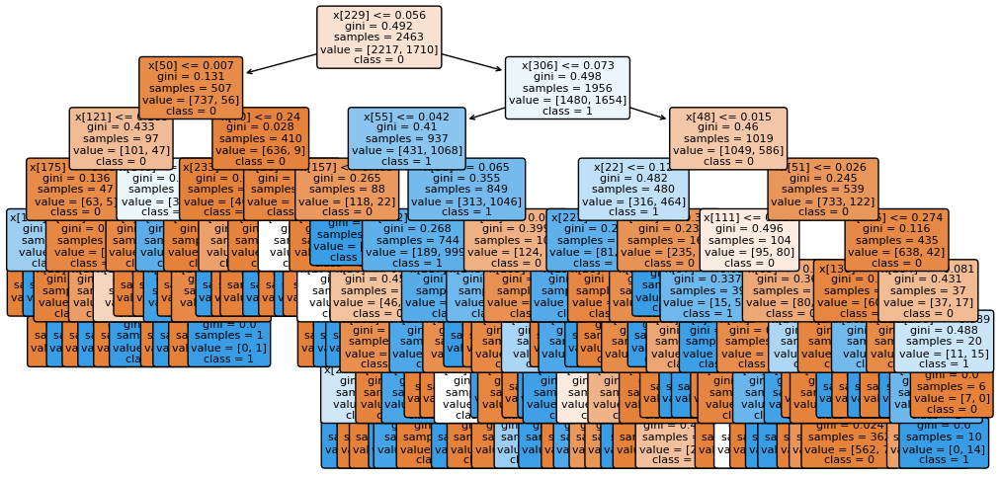

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=80701568)


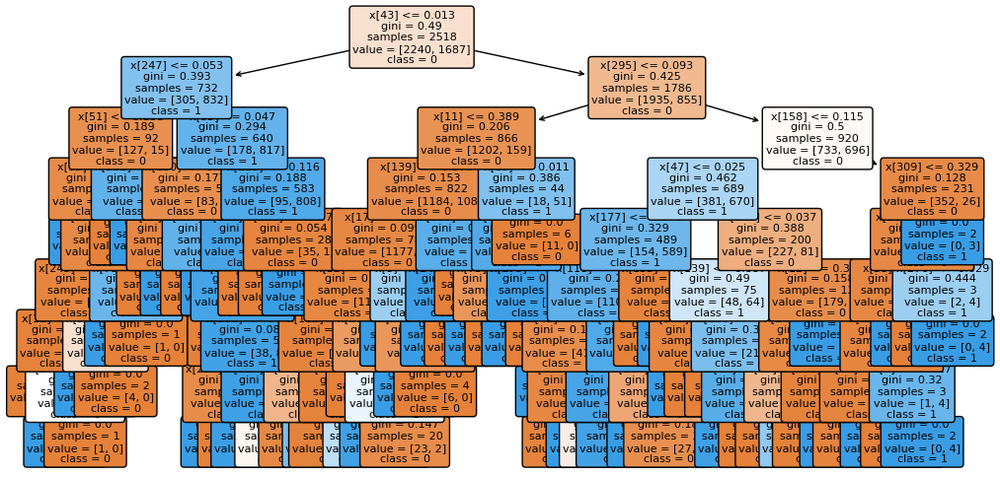

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1392175012)


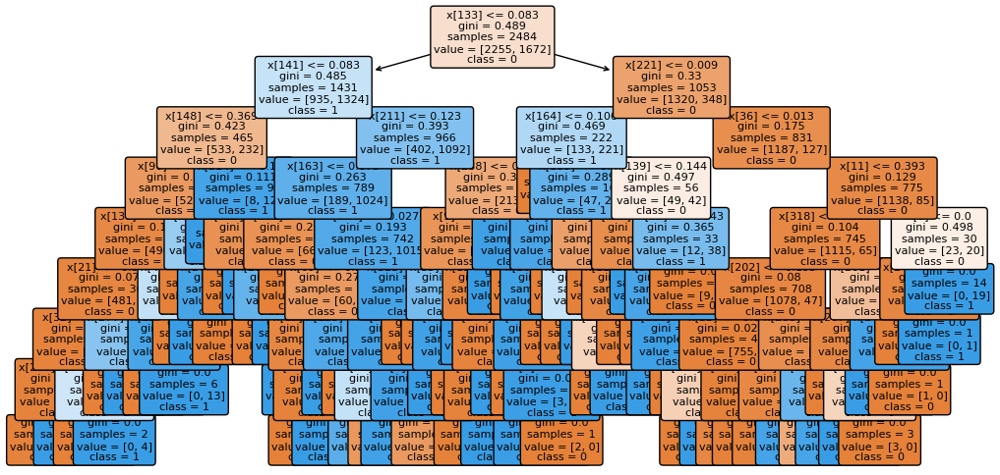

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=505240629)


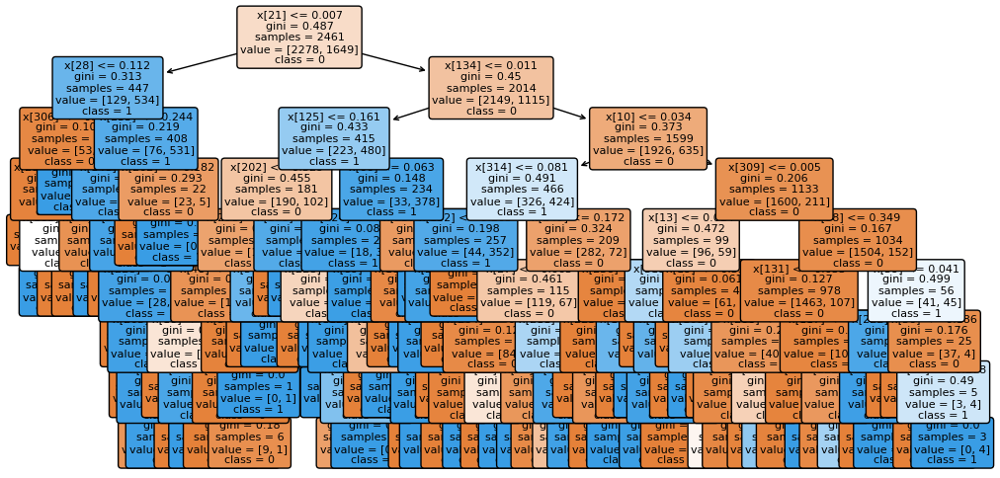

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=642848645)


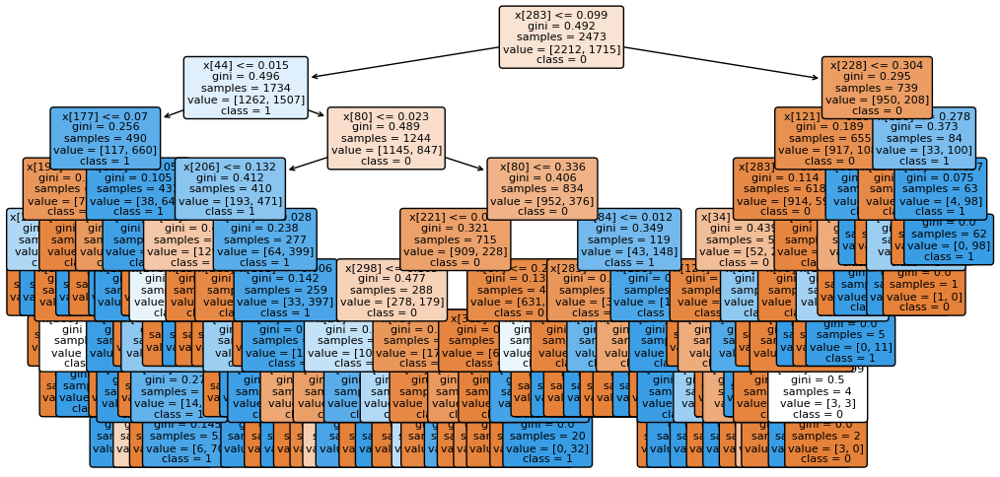

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=481447462)


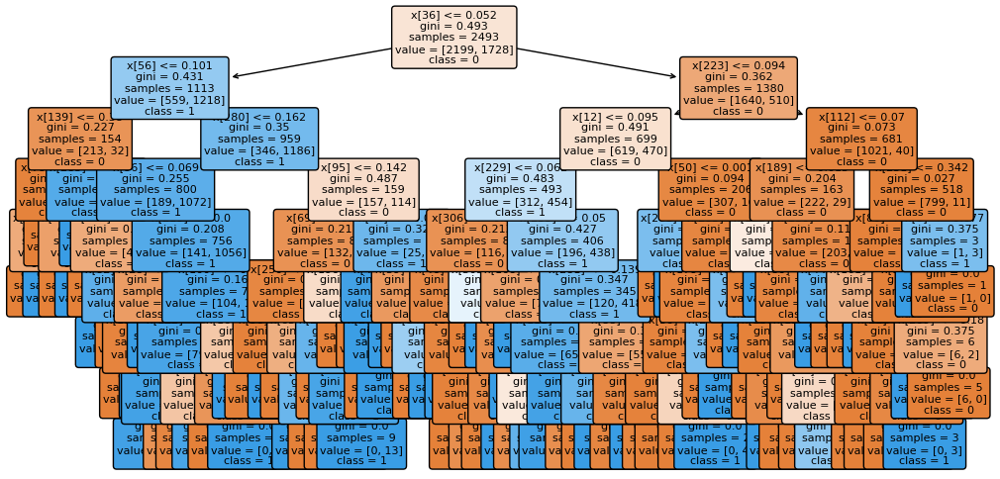

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=954863080)


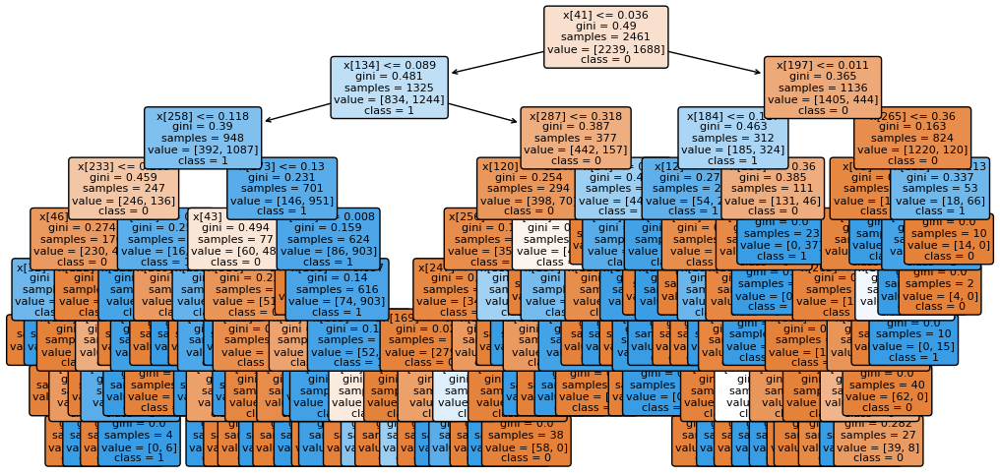

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=502227700)


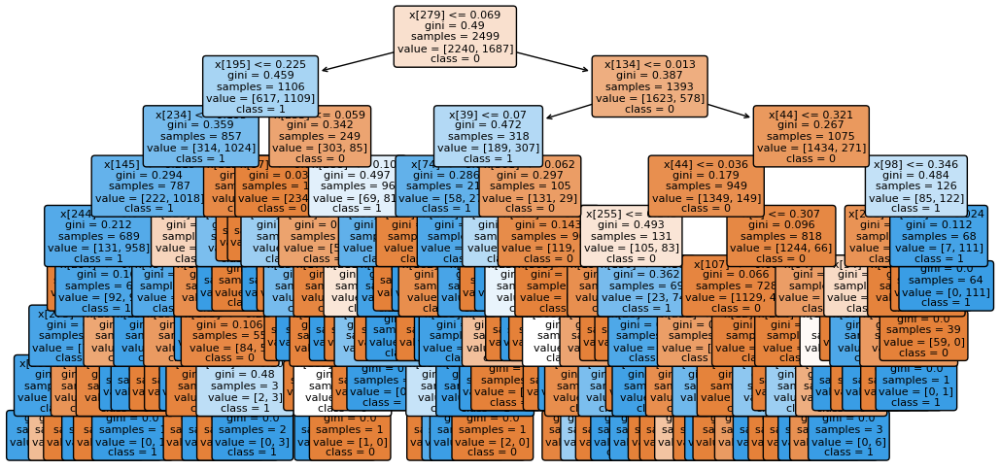

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1659957521)


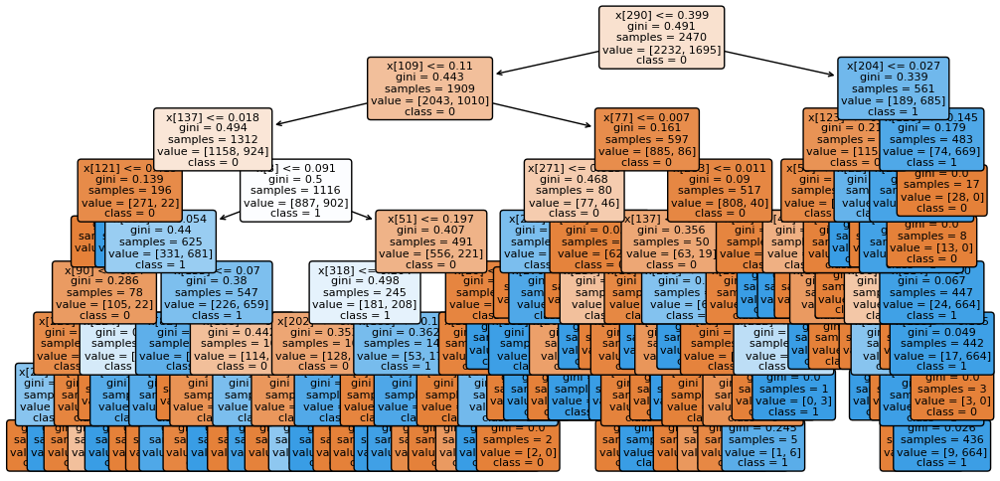

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1905883471)


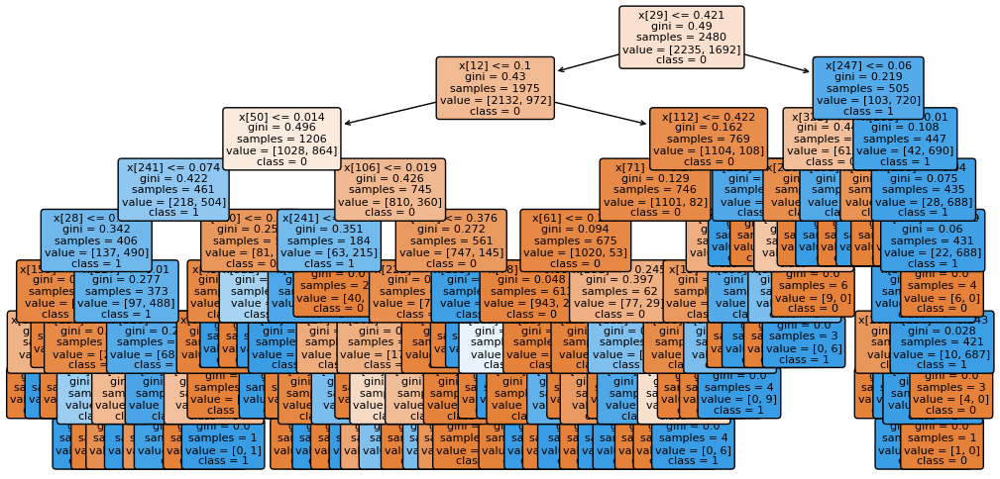

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1729147268)


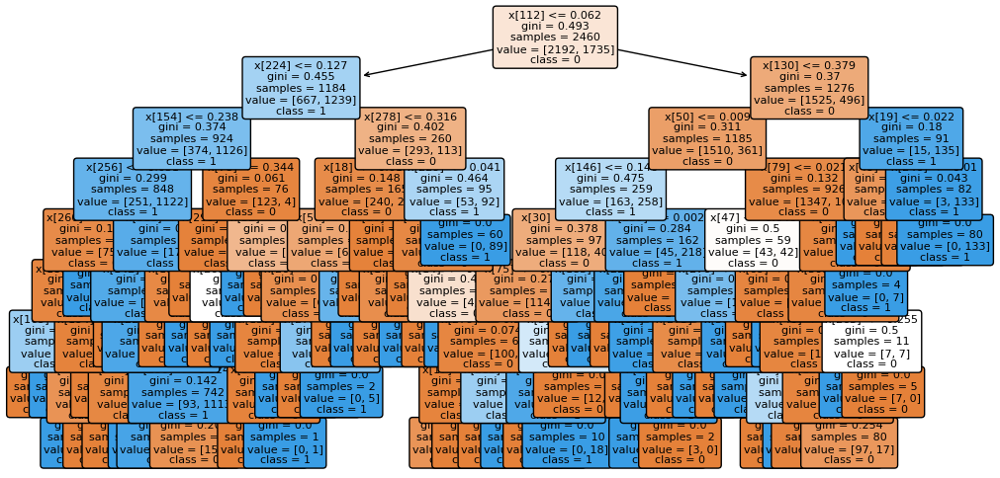

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=780912233)


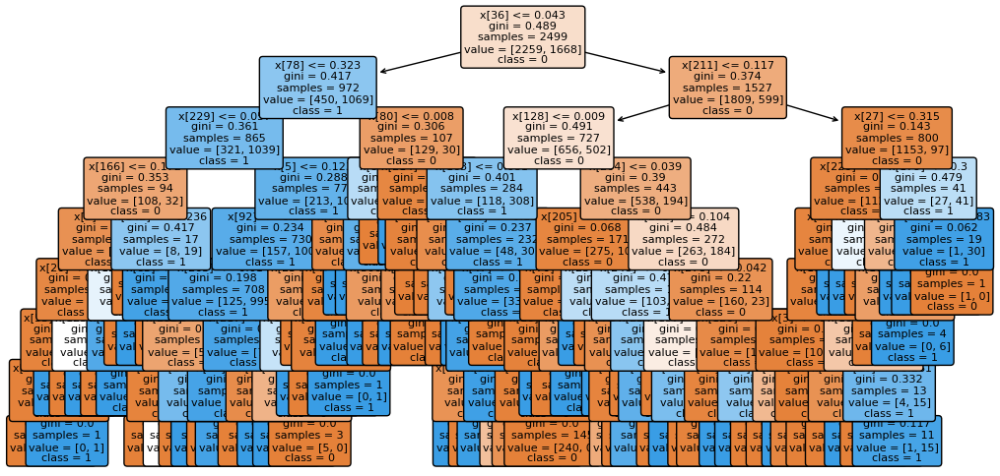

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1932520490)


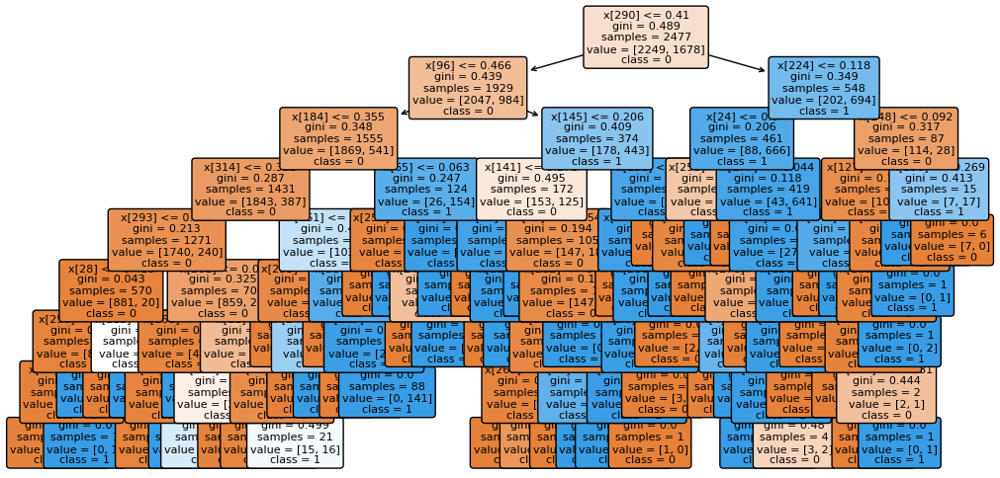

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1544074682)


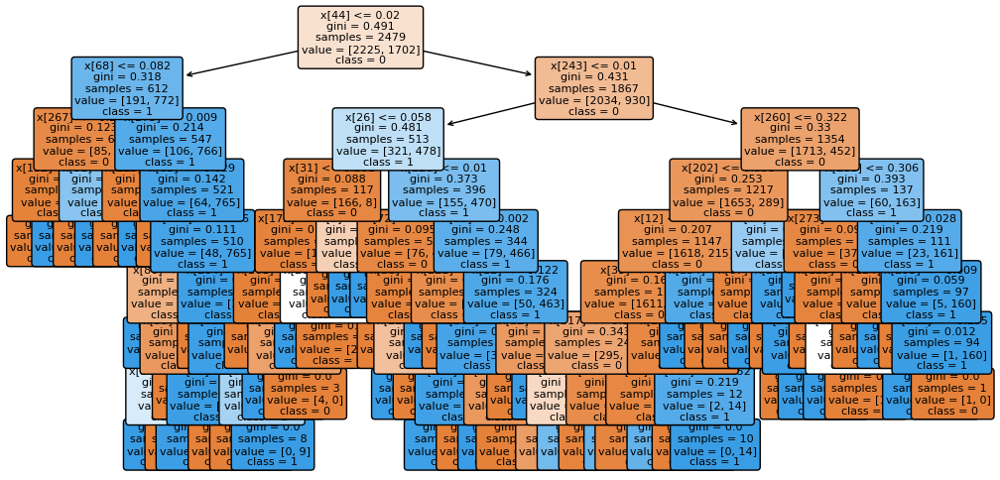

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=485603871)


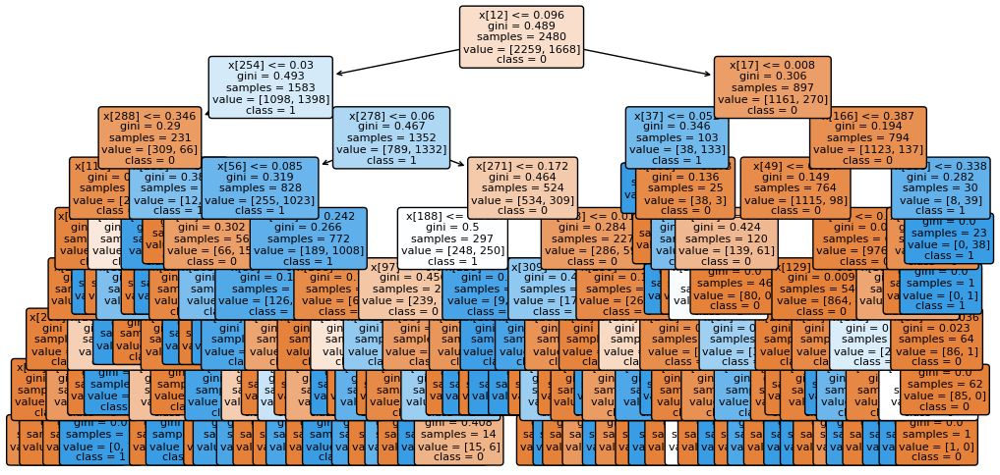

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1877037944)


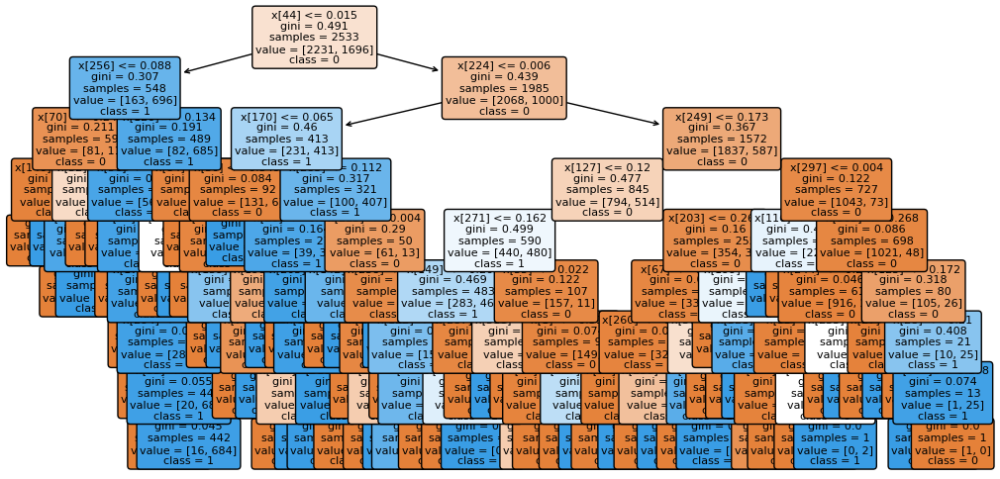

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1728073985)


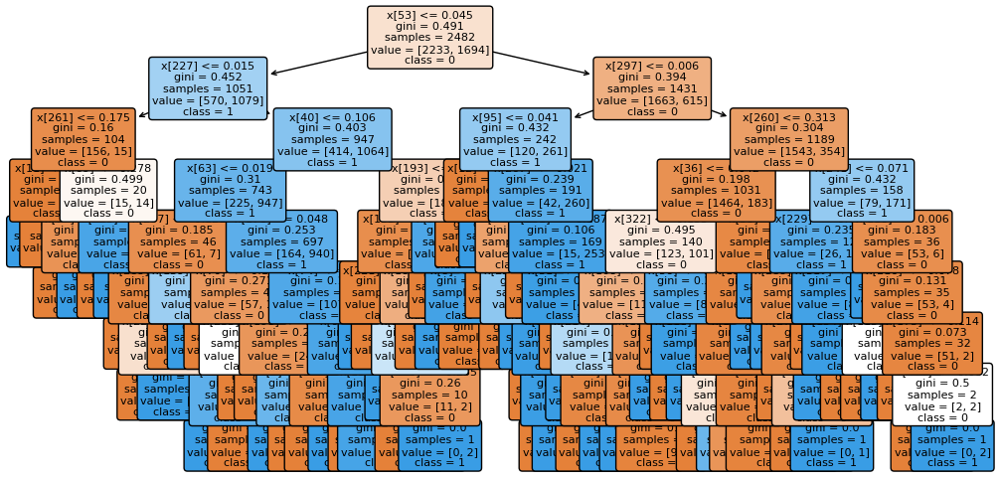

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=848819521)


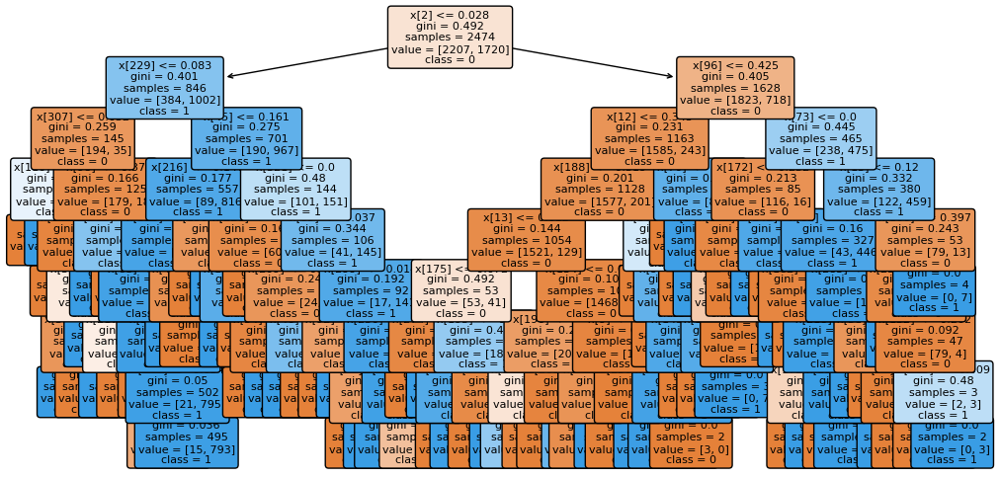

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=426405863)


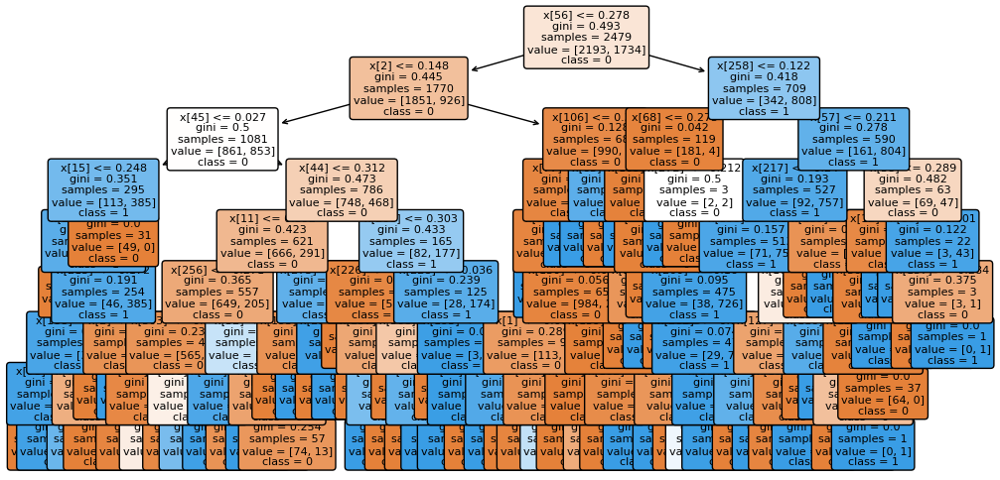

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=258666409)


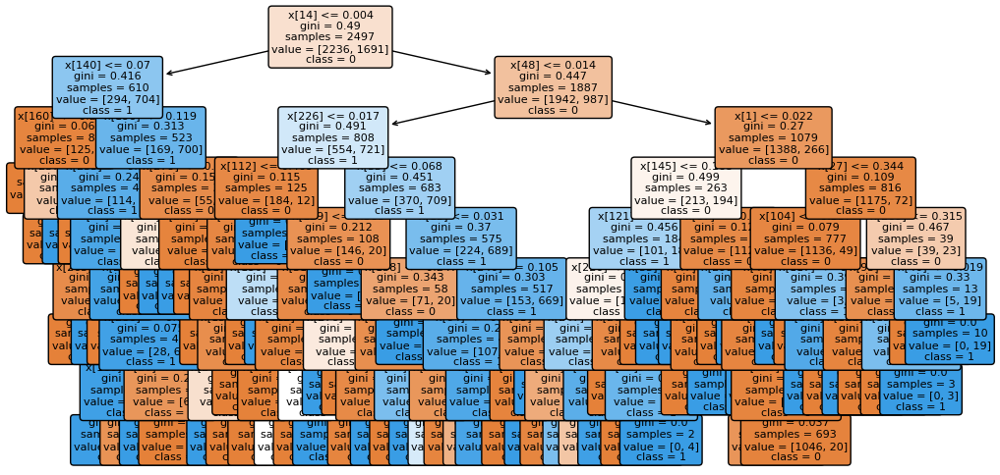

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=2017814585)


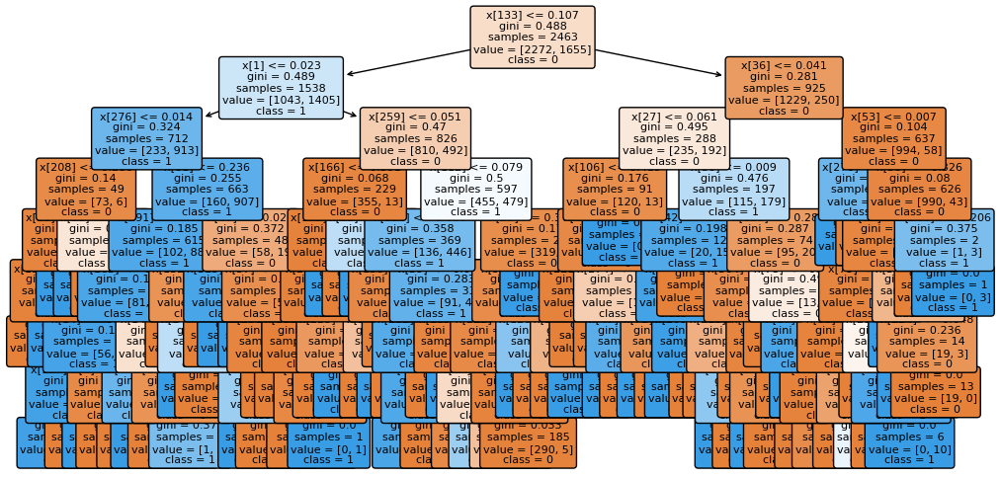

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=716257571)


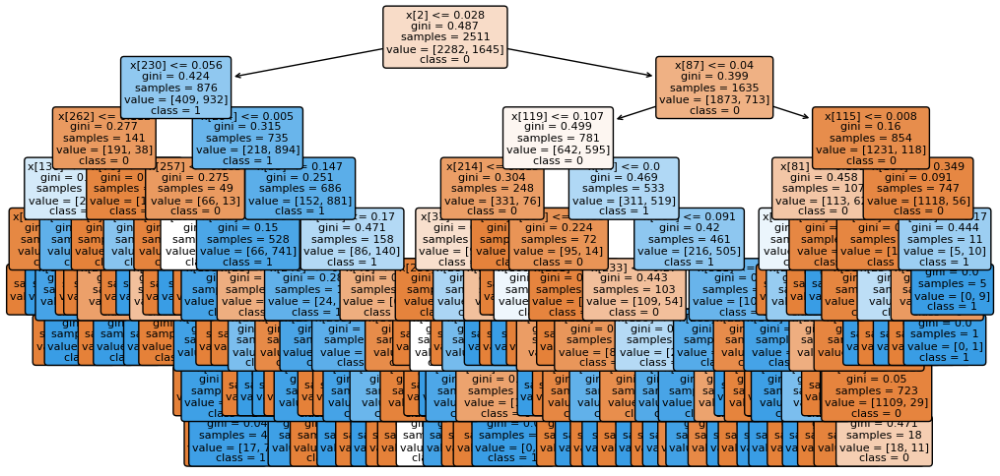

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=657731430)


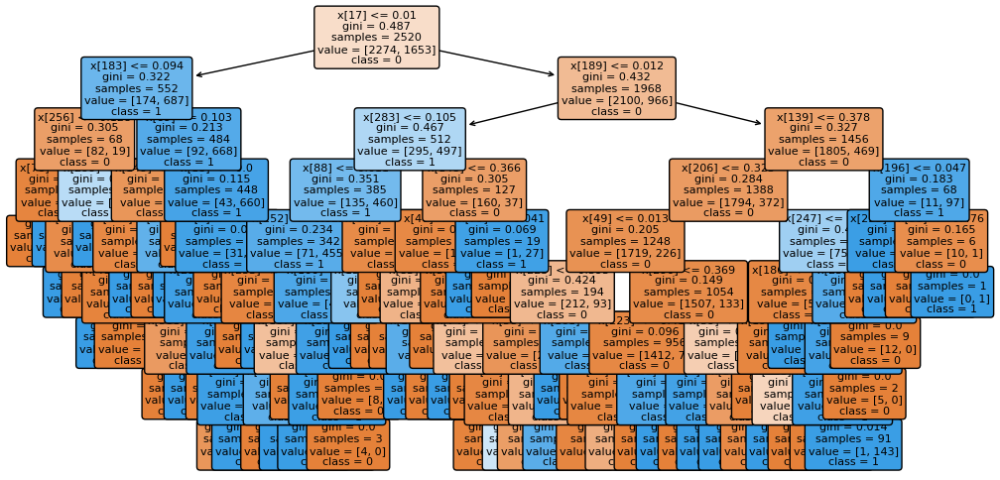

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=732884087)


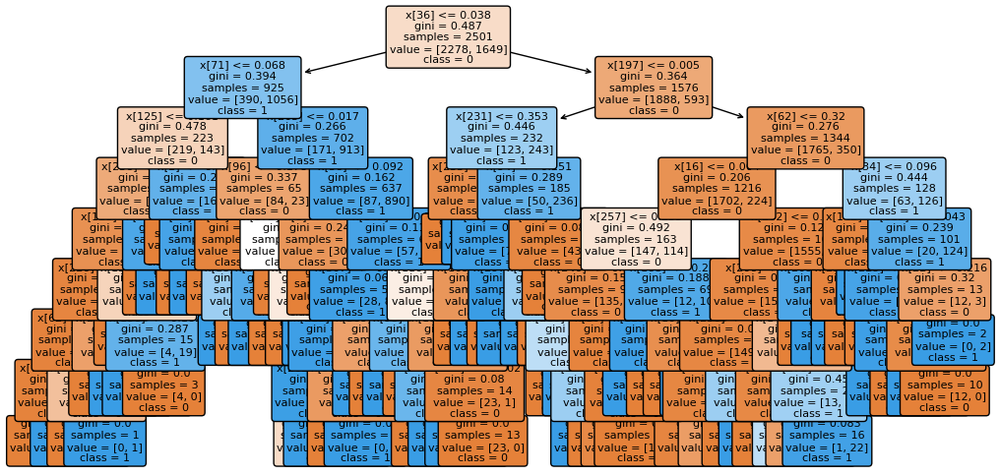

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=734051083)


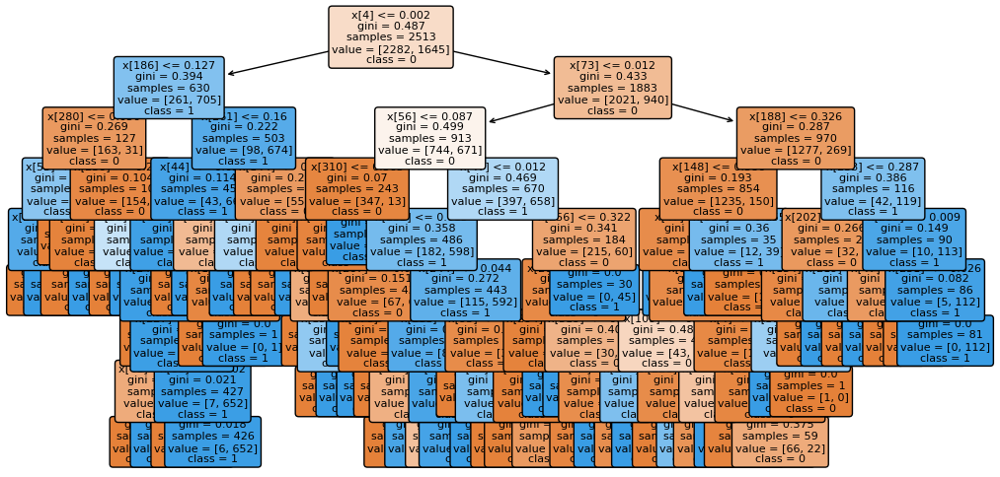

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=903586222)


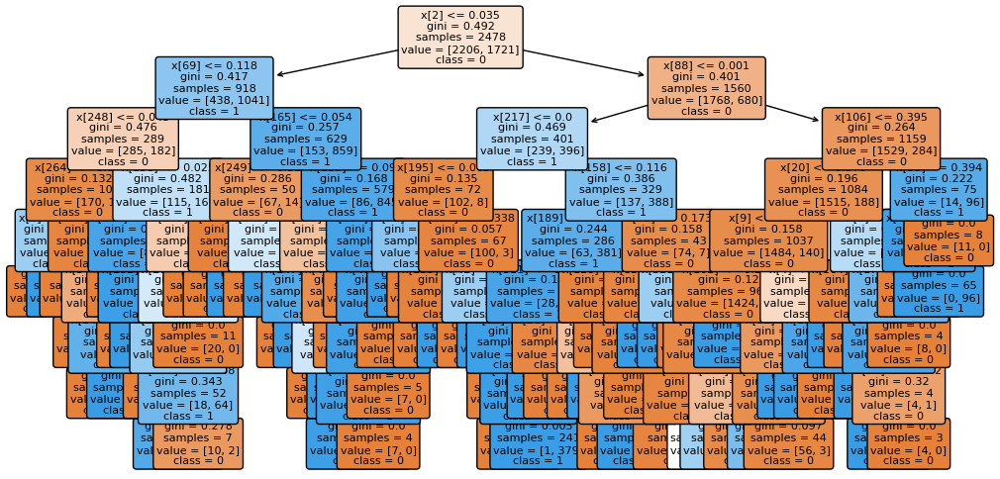

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1538251858)


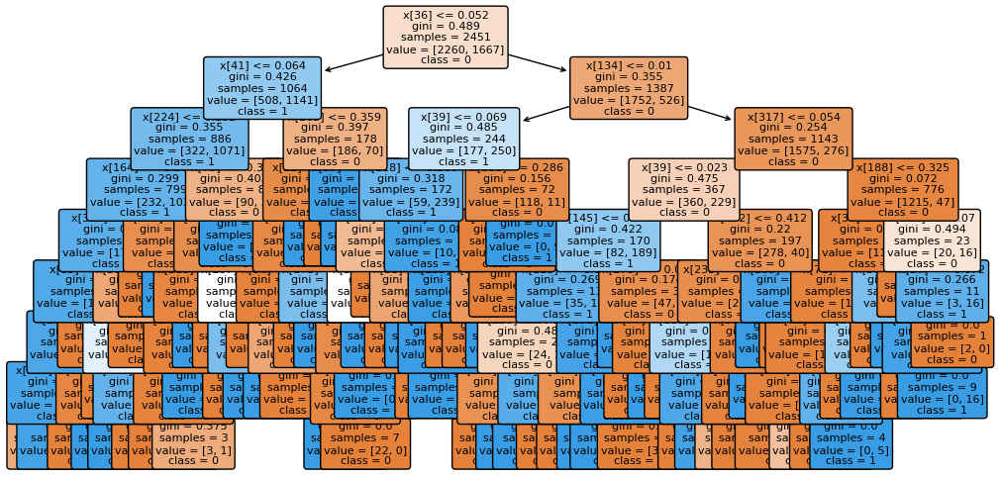

DecisionTreeClassifier(max_depth=8, max_features='sqrt', random_state=553734235)


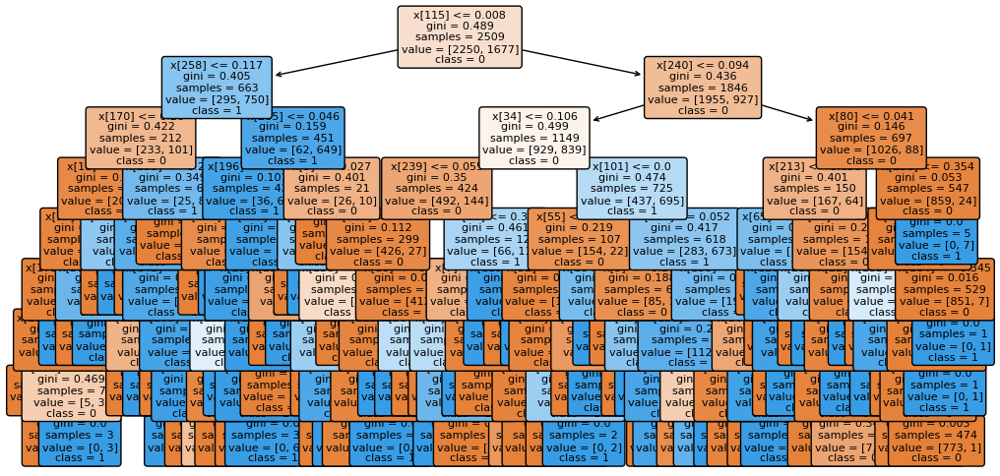

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1076688768)


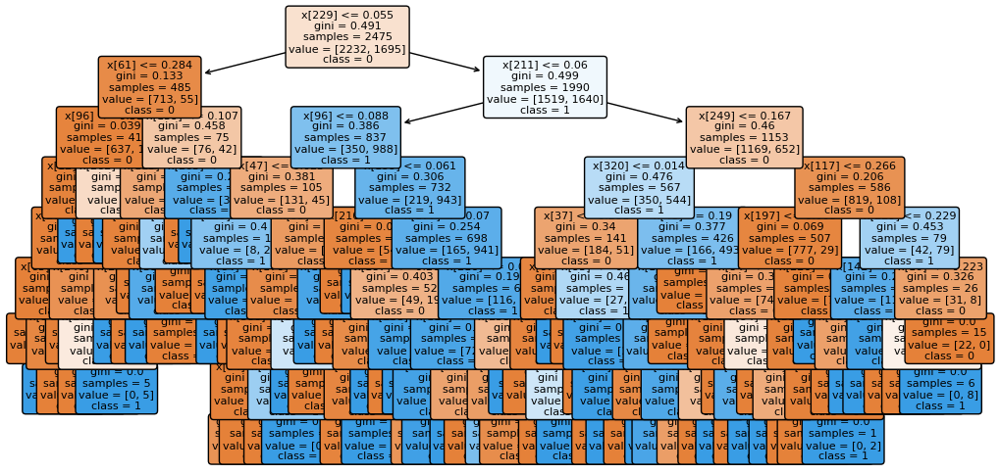

DecisionTreeClassifier(max_depth=8, max_features='sqrt',
                       random_state=1354754446)


KeyboardInterrupt: 

In [ ]:
from sklearn import tree


classes = ['0', '1'] # The name of each class

for estimator in clf_2.estimators_:
    print(estimator)
    plt.figure(figsize=(12,6))
    tree.plot_tree(estimator,
                   class_names=classes,
                   fontsize=8,
                   filled=True,
                   rounded=True)
    plt.show()




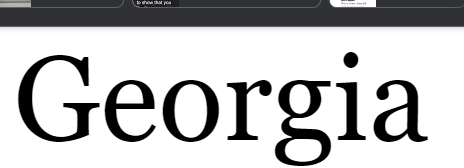

Handwritten


In [ ]:
from google.colab.patches import cv2_imshow


image1 = cv2.imread("/content/Screenshot 2024-07-12 043647.png")
# Predict using the trained classifier
cv2_imshow(image1)
feature1 = load_extract_feature("/content/Screenshot 2024-07-12 043647.png")
feature2 = feature1.reshape(1,324)
prediction = clf_2.predict(feature2)


# Draw bounding box and label on the image
label = "Handwritten" if prediction == 0 else "Printed"
color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
print(label)
# cv2.rectangle(feature1, (x, y), (x+w, y+h), color, 2)
# cv2.putText(word_img, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

classifier = KNeighborsClassifier(n_neighbors=5)
classifier.fit(X_train,y_train)

KNeighborsClassifier()

y_perd = classifier.predict(X_test)

print(accuracy_score(y_test,y_perd))
print(classification_report(y_test,y_perd))
confusion_matrix(y_test,y_perd)

0.9465859030837004
              precision    recall  f1-score   support

           0       1.00      0.87      0.93       759
           1       0.92      1.00      0.96      1057

    accuracy                           0.95      1816
   macro avg       0.96      0.94      0.94      1816
weighted avg       0.95      0.95      0.95      1816



array([[ 662,   97],
       [   0, 1057]])

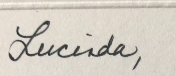

Printed


In [ ]:
from google.colab.patches import cv2_imshow


image1 = cv2.imread("/content/Screenshot 2024-07-14 174520.png")
# Predict using the trained classifier
cv2_imshow(image1)
feature1 = load_extract_feature("/content/Screenshot 2024-07-14 174520.png")
feature2 = feature1.reshape(1,324)
prediction = classifier.predict(feature2)


# Draw bounding box and label on the image
label = "Handwritten" if prediction == 0 else "Printed"
color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
print(label)
# cv2.rectangle(feature1, (x, y), (x+w, y+h), color, 2)
# cv2.putText(word_img, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

In [ ]:
from sklearn.svm import SVC

X1 = A[:,0:2]
print(X1)
print(B)
print(X1.shape)

X_train,X_test,y_train,y_test=train_test_split(X1,B,random_state=0)
clf_3 = SVC()
clf_3.fit(X_train, y_train)

y_test_predicted=clf_3.predict(X_test)

print(accuracy_score(y_test,y_test_predicted))
print(classification_report(y_test,y_test_predicted))
confusion_matrix(y_test,y_test_predicted)

[[2.86468595e-01 2.03450292e-01]
 [2.86702096e-01 2.86702096e-01]
 [5.66892512e-02 4.11081575e-02]
 ...
 [5.62533278e-05 1.37414145e-05]
 [5.68748837e-05 6.41499064e-05]
 [1.56063194e-04 1.62021941e-04]]
[0 0 0 ... 1 1 1]
(7263, 2)
0.7092511013215859
              precision    recall  f1-score   support

           0       0.77      0.43      0.55       759
           1       0.69      0.91      0.78      1057

    accuracy                           0.71      1816
   macro avg       0.73      0.67      0.67      1816
weighted avg       0.72      0.71      0.69      1816



array([[328, 431],
       [ 97, 960]])

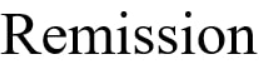

ValueError: X has 324 features, but SVC is expecting 2 features as input.

In [ ]:
from google.colab.patches import cv2_imshow


image1 = cv2.imread("/content/Screenshot 2024-07-06 111534.png")
# Predict using the trained classifier
cv2_imshow(image1)
feature1 = load_extract_feature("/content/Screenshot 2024-07-06 111534.png")
feature2 = feature1.reshape(1,324)
prediction = clf_3.predict(feature2)


# Draw bounding box and label on the image
label = "Handwritten" if prediction == 0 else "Printed"
color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
print(label)
# cv2.rectangle(feature1, (x, y), (x+w, y+h), color, 2)
# cv2.putText(word_img, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

In [ ]:
clf_4 = SVC(kernel = 'rbf', random_state = 0)
clf_4.fit(X_train, y_train)
y_train_predicted=clf_4.predict(X_train)
y_test_predicted=clf_4.predict(X_test)
accuracy_score(y_train,y_train_predicted)
accuracy_score(y_test,y_test_predicted)

0.7092511013215859

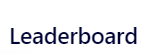

ValueError: X has 324 features, but SVC is expecting 2 features as input.

In [ ]:
from google.colab.patches import cv2_imshow


image1 = cv2.imread("/content/Screenshot 2024-07-12 044857.png")
# Predict using the trained classifier
cv2_imshow(image1)
feature1 = load_extract_feature("/content/Screenshot 2024-07-12 044857.png")
feature2 = feature1.reshape(1,324)
prediction = clf_3.predict(feature2)


# Draw bounding box and label on the image
label = "Handwritten" if prediction == 0 else "Printed"
color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
print(label)
# cv2.rectangle(feature1, (x, y), (x+w, y+h), color, 2)
# cv2.putText(word_img, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

In [ ]:
clf_4 = SVC(kernel = 'linear', random_state = 0)
clf_4.fit(X_train, y_train)
y_train_predicted=clf_4.predict(X_train)
y_test_predicted=clf_4.predict(X_test)
accuracy_score(y_train,y_train_predicted)
accuracy_score(y_test,y_test_predicted)

0.6453744493392071

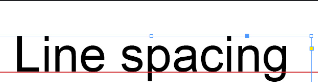

ValueError: X has 324 features, but SVC is expecting 2 features as input.

In [ ]:
from google.colab.patches import cv2_imshow


image1 = cv2.imread("/content/Screenshot 2024-07-12 044026.png")
# Predict using the trained classifier
cv2_imshow(image1)
feature1 = load_extract_feature("/content/Screenshot 2024-07-12 044026.png")
feature2 = feature1.reshape(1,324)
prediction = clf_4.predict(feature2)


# Draw bounding box and label on the image
label = "Handwritten" if prediction == 0 else "Printed"
color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
print(label)
# cv2.rectangle(feature1, (x, y), (x+w, y+h), color, 2)
# cv2.putText(word_img, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

In [ ]:
from pathlib import Path


model_path = Path('random_forest_classifier_2.pkl')
joblib.dump(clf_2, model_path)

print(f"Model saved to {model_path}")

Model saved to random_forest_classifier_2.pkl


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# MLP Classifier
# adam-optimiser =
# hidden_layer_sizes = 128, 528
# lrate = .001
# max_iter = 10000

# max iter=10000
# hidden layer output (128,512,128)
# optimizer=Adam
# lrate=0.0001


# confidence scorer=accuracy

In [ ]:
from sklearn.neural_network import MLPClassifier

print(X_train.shape)
print(X_test.shape)

clf_MLP = MLPClassifier(random_state=1, max_iter=10000,hidden_layer_sizes=(128,512,128),learning_rate_init=0.0001).fit(X_train, y_train)
y_test_predicted=clf_MLP.predict(X_test)
print(clf_MLP.predict_proba(X_test))
print(accuracy_score(y_test,y_test_predicted))
print(clf_MLP.score(X_test, y_test))
print(classification_report(y_test,y_test_predicted))
confusion_matrix(y_test,y_test_predicted)

(5447, 324)
(1816, 324)
[[3.26580898e-06 9.99996734e-01]
 [9.99947770e-01 5.22295786e-05]
 [9.99976508e-01 2.34919925e-05]
 ...
 [9.99993184e-01 6.81559161e-06]
 [9.99999999e-01 6.97466633e-10]
 [4.14378486e-06 9.99995856e-01]]
0.9900881057268722
0.9900881057268722
              precision    recall  f1-score   support

           0       0.99      0.98      0.99       759
           1       0.99      0.99      0.99      1057

    accuracy                           0.99      1816
   macro avg       0.99      0.99      0.99      1816
weighted avg       0.99      0.99      0.99      1816



array([[ 747,   12],
       [   6, 1051]])

In [ ]:
from sklearn.neural_network import MLPClassifier

layer_sizes = [(64,),(128,),(128, 64),(128, 128),(128,512,128),(256, 128, 64),(512, 256, 128)]

hidden_layers=[]   #will store all the models here
for layer in layer_sizes:
    clf_mlp_class=MLPClassifier(random_state=1, max_iter=10000,hidden_layer_sizes=layer,learning_rate_init=0.0001)
    clf_mlp_class.fit(X_train,y_train)
    hidden_layers.append(clf_mlp_class)
# print("Last node in Decision tree is {} and ccp_alpha for last node is {}".format(hidden_layers[-1]))
print(hidden_layers)

[MLPClassifier(hidden_layer_sizes=(64,), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128,), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 64), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(256, 128, 64), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(512, 256, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=1)]


In [ ]:
learning_values = [0.000001,0.0001,0.01,0.1,0.125]

learning_rates=[]

for learning_rate_init in learning_values:
    print(learning_rate_init)
    clf_mlp_class=MLPClassifier(random_state=1, max_iter=10000,hidden_layer_sizes=(128,512,128),learning_rate_init=learning_rate_init)
    clf_mlp_class.fit(X_train,y_train)
    learning_rates.append(clf_mlp_class)
# print("Last node in Decision tree is {} and ccp_alpha for last node is {}".format(hidden_layers[-1].tree_.node_count,layer_sizes[-1]))
print(learning_rates)

1e-06
0.0001
0.01
0.1
0.125
[MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=1e-06,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.01,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.1,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.125,
              max_iter=10000, random_state=1)]


In [ ]:
random_states=[]

for random_state in range(1,42):
    # print(random_state)
    clf_mlp_class=MLPClassifier(random_state=random_state, max_iter=10000,hidden_layer_sizes=(128,512,128),learning_rate_init=0.0001)
    clf_mlp_class.fit(X_train,y_train)
    random_states.append(clf_mlp_class)
# print("Last node in Decision tree is {} and ccp_alpha for last node is {}".format(hidden_layers[-1].tree_.node_count,layer_sizes[-1]))
print(random_states)

[MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=1), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=2), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=3), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=4), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=5), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=6), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=7), MLPClassifier(hidden_layer_sizes=(128, 512, 128), learning_rate_init=0.0001,
              max_iter=10000, random_state=8), MLPClas

In [ ]:
from sklearn.model_selection import GridSearchCV

parameter_space = {
    'hidden_layer_sizes': [(64,),(128,),(128, 64),(128, 128),(128,512,128),(256, 128, 64),(512, 256, 128)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
    'learning_rate_init': [0.001, 0.0001],
}

mlp = MLPClassifier(max_iter=10000)

clf_mlp_bestfit = GridSearchCV(mlp, parameter_space,n_jobs=-1, cv=3)
clf_mlp_bestfit.fit(X_train,y_train)

# Best paramete set
print('Best parameters found:\n', clf_mlp_bestfit.best_params_)

# All results
means = clf_mlp_bestfit.cv_results_['mean_test_score']
stds = clf_mlp_bestfit.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf_mlp_bestfit.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (mean, std * 2, params))

KeyboardInterrupt: 

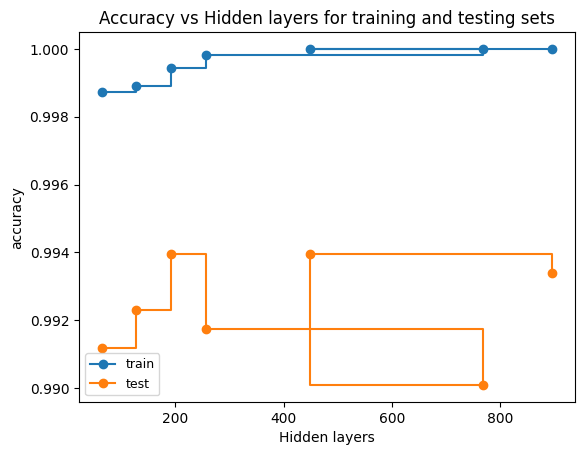

In [ ]:
num_neurons = [sum(layer) for layer in layer_sizes]

train_scores = [clf_mlp_class.score(X_train, y_train) for clf_mlp_class in hidden_layers]
test_scores = [clf_mlp_class.score(X_test, y_test) for clf_mlp_class in hidden_layers]
fig, ax = plt.subplots()
ax.set_xlabel("Hidden layers")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs Hidden layers for training and testing sets")
ax.plot(num_neurons, train_scores, marker='o', label="train",drawstyle="steps-post")
ax.plot(num_neurons, test_scores, marker='o', label="test",drawstyle="steps-post")
ax.legend(fontsize=9)
plt.show()

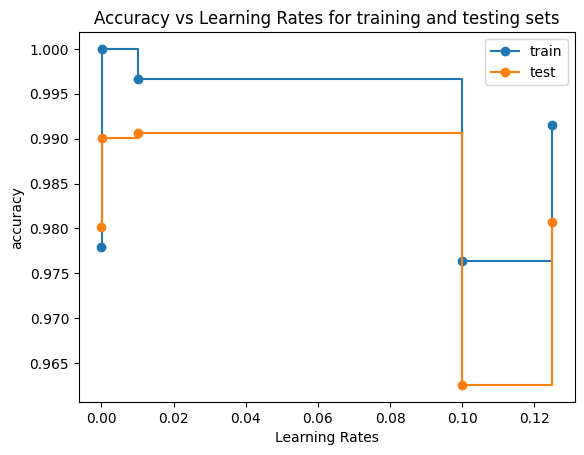

In [ ]:
# num_neurons = [sum(layer) for layer in learning_values]

train_scores = [clf_mlp_class.score(X_train, y_train) for clf_mlp_class in learning_rates]
test_scores = [clf_mlp_class.score(X_test, y_test) for clf_mlp_class in learning_rates]
fig, ax = plt.subplots()
ax.set_xlabel("Learning Rates")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs Learning Rates for training and testing sets")
ax.plot(learning_values, train_scores, marker='o', label="train",drawstyle="steps-post")
ax.plot(learning_values, test_scores, marker='o', label="test",drawstyle="steps-post")
ax.legend()
plt.show()

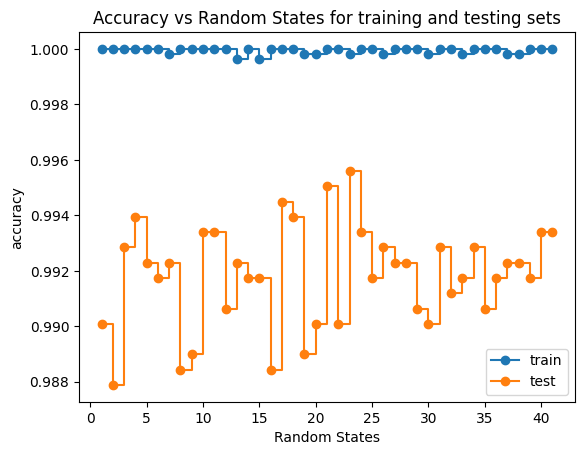

In [ ]:
train_scores = [clf_mlp_class.score(X_train, y_train) for clf_mlp_class in random_states]
test_scores = [clf_mlp_class.score(X_test, y_test) for clf_mlp_class in random_states]
fig, ax = plt.subplots()
ax.set_xlabel("Random States")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs Random States for training and testing sets")
ax.plot(list(range(1, 42)), train_scores, marker='o', label="train",drawstyle="steps-post")
ax.plot(list(range(1, 42)), test_scores, marker='o', label="test",drawstyle="steps-post")
ax.legend()
plt.show()

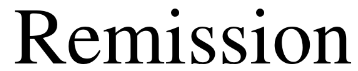

(1, 72)
Printed
[[0. 1.]]


In [ ]:
from google.colab.patches import cv2_imshow


image1 = cv2.imread("/content/Screenshot 2024-07-12 045950.png")
# Predict using the trained classifier
cv2_imshow(image1)
feature1 = load_extract_feature("/content/Screenshot 2024-07-12 045950.png")
feature2 = feature1.reshape(1,72)

print(feature2.shape)

prediction = clf_MLP.predict(feature2)


# Draw bounding box and label on the image
label = "Handwritten" if prediction == 0 else "Printed"
color = (0, 255, 0) if prediction == 0 else (0, 0, 255)
print(label)
# cv2.rectangle(feature1, (x, y), (x+w, y+h), color, 2)
# cv2.putText(word_img, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
print(clf_MLP.predict_proba(feature2))

In [ ]:
from pathlib import Path


model_path = Path('MLP_classifier_glcm.pkl')
joblib.dump(clf_MLP, model_path)

print(f"Model saved to {model_path}")

Model saved to MLP_classifier_glcm.pkl


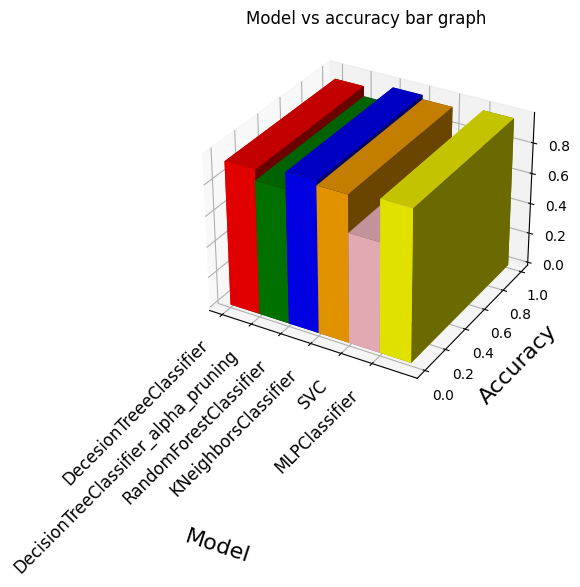

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import Patch

model=['DecesionTreeeClassifier', 'DecisionTreeClassifier_alpha_pruning','RandomForestClassifier', 'KNeighborsClassifier', 'SVC', 'MLPClassifier']
accuracy=[0.9333700440528634, 0.8667400881057269,0.9741189427312775,0.9465859030837004,0.7092511013215859,0.9752202643171806]
colors = ['red', 'green', 'blue', 'orange','pink','yellow']


accuracy = pd.DataFrame({'Model': model, 'Accuracy': accuracy})

# # Create a bar chart
# Create figure and 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Data for plotting
x = np.arange(len(accuracy['Model']))
y = np.zeros(len(accuracy['Model']))
z = np.zeros(len(accuracy['Model']))
dx = np.ones(len(accuracy['Model']))
dy = np.ones(len(accuracy['Model']))
dz = accuracy['Accuracy']

# Plot 3D bars (cylindrical-like)
ax.bar3d(x, y, z, dx, dy, dz, color=colors)


# Set labels
ax.set_xticks(x)
ax.set_xticklabels(accuracy['Model'],rotation=45, ha='right', fontsize=12)
ax.set_xlabel('Model',fontsize=16, labelpad=80, rotation=0)
ax.set_ylabel('Accuracy',fontsize=16,labelpad=8)
# ax.set_zlabel('Accuracy',fontsize=8, loc='left')

plt.title('Model vs accuracy bar graph')


plt.show()

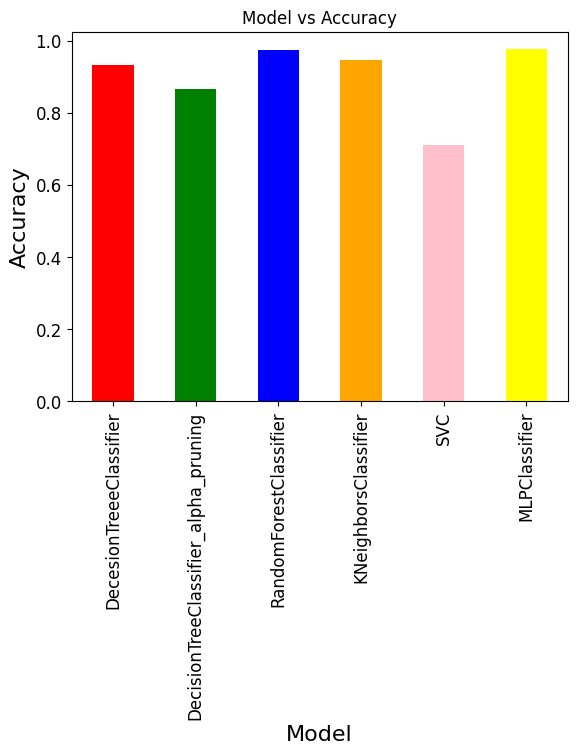

In [ ]:
model=['DecesionTreeeClassifier', 'DecisionTreeClassifier_alpha_pruning','RandomForestClassifier', 'KNeighborsClassifier', 'SVC', 'MLPClassifier']
accuracy=[0.9333700440528634, 0.8667400881057269,0.9741189427312775,0.9465859030837004,0.7092511013215859,0.9752202643171806]
colors = ['red', 'green', 'blue', 'orange','pink','yellow', 'brown']

accuracy = pd.DataFrame({'Model': model, 'Accuracy': accuracy})

accuracy.plot(kind="bar", x="Model", y="Accuracy", color=colors, legend=False, fontsize=12)

plt.title('Model vs Accuracy')
plt.xlabel('Model',fontsize=16)
plt.ylabel('Accuracy', fontsize=16)

plt.show()